In [1]:
from google.colab import drive
drive.mount('/content/gdrive')

Mounted at /content/gdrive


In [2]:
import cv2
import numpy as np
import matplotlib.pyplot as plt

## Color Mappings

--- cvtColor function


In [3]:
img = cv2.imread('gdrive/My Drive/Datasets/DATA/00-puppy.jpg')# if we pass wrong while reading file in cv2 it does not give an error but it returns img as none type.
type(img)  # So, It is better practice to print the type of image. if it is returning NoneType that means the file path must be wrong.

numpy.ndarray

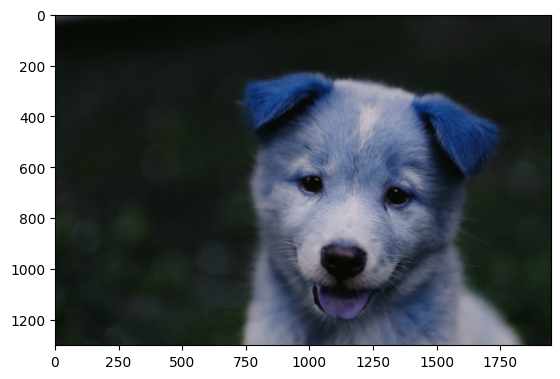

In [4]:
plt.imshow(img)

In [5]:
fix_img = cv2.cvtColor(img,cv2.COLOR_BGR2RGB)

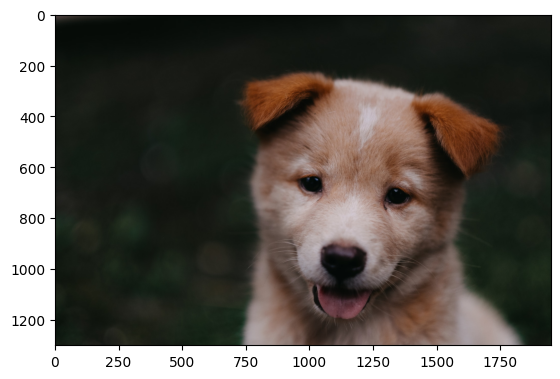

In [6]:
plt.imshow(fix_img)

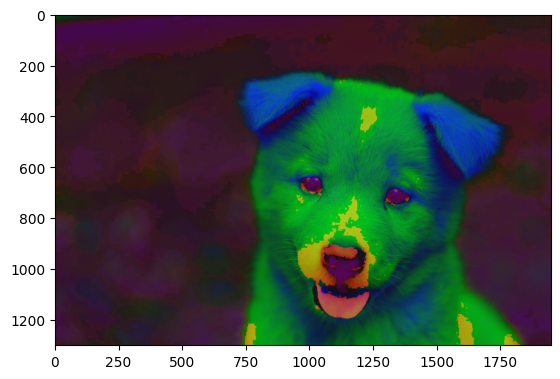

In [7]:
## HSL image
hsl = cv2.cvtColor(img,cv2.COLOR_BGR2HLS)
plt.imshow(hsl)  ### This weird result because is not encoded originally in this way.


## Blending and Pasring Images.

* add Weighted function is used for this purpose.
* It uses both images and combines them.

Formula to blend images.
new_pixel = alpha x pixel_1 + beta x  pixel_2 + gemma


In [8]:
img1 = cv2.imread('gdrive/My Drive/Datasets/DATA/dog_backpack.png')
print(type(img1))
img1 = cv2.cvtColor(img1,cv2.COLOR_BGR2RGB)
img2 = cv2.imread('gdrive/My Drive/Datasets/DATA/watermark_no_copy.png')
print(type(img2))
img2 = cv2.cvtColor(img2,cv2.COLOR_BGR2RGB)

<class 'numpy.ndarray'>
<class 'numpy.ndarray'>


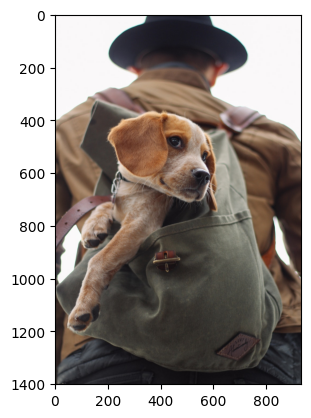

In [9]:
plt.imshow(img1)

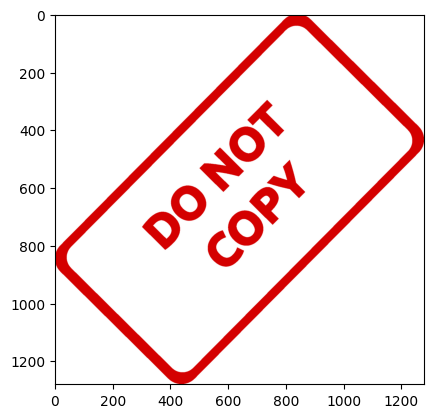

In [10]:
plt.imshow(img2)

In [11]:
### TO perform blending and pasting operation in cv2 both images must be in same .
### So, as the above two pictures have different dimensions we need to make their dimension equal before performing any blending operation

print(img1.shape)
print(img2.shape)

## BLENDING IMAGES OF SAME SIZE

img1 = cv2.resize(img1,(1200,1200))   ## It sequeeze image 1 a little bit.
img2 = cv2.resize(img2,(1200,1200))




(1401, 934, 3)
(1280, 1277, 3)


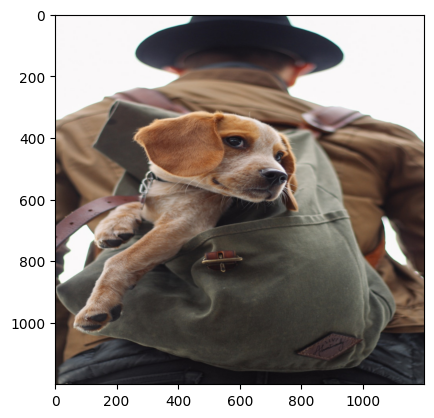

In [12]:
plt.imshow(img1)

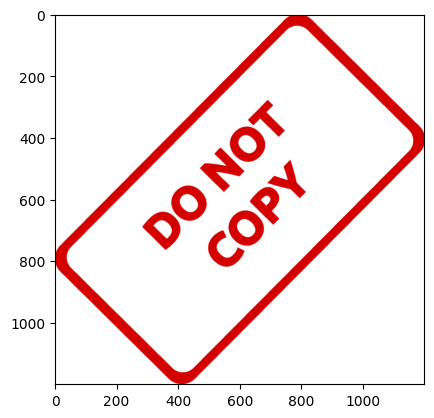

In [13]:
plt.imshow(img2)

In [14]:
### we can control blrnding  through alpha and beta argumenets.
# --> we can increase aplha increase to make img1 more shining and decrease the value of beta to make img2 less shining.
blended = cv2.addWeighted(src1= img1,alpha = 0.5,src2=img2,beta = 0.5,gamma = 0)

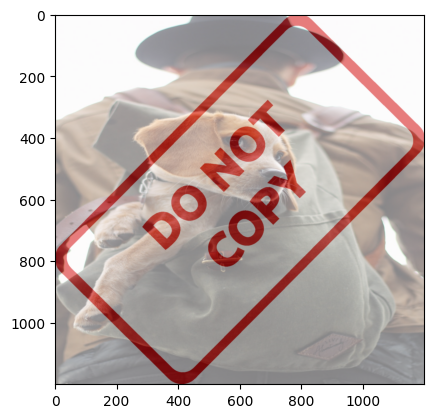

In [15]:
plt.imshow(blended)

In [16]:
### OVERLAY SMALL IMAGE ON TOP OF A LARGER IMAGE (NO BLENDING)
### By using numpy.

img1 = cv2.imread('gdrive/My Drive/Datasets/DATA/dog_backpack.png')
print(type(img1))
img1 = cv2.cvtColor(img1,cv2.COLOR_BGR2RGB)
img2 = cv2.imread('gdrive/My Drive/Datasets/DATA/watermark_no_copy.png')
print(type(img2))
img2 = cv2.cvtColor(img2,cv2.COLOR_BGR2RGB)

<class 'numpy.ndarray'>
<class 'numpy.ndarray'>


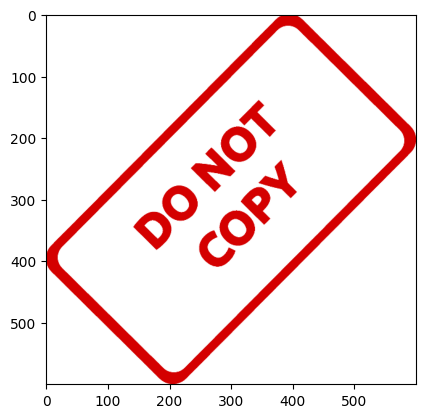

In [17]:
img2 = cv2.resize(img2,(600,600))
plt.imshow(img2)

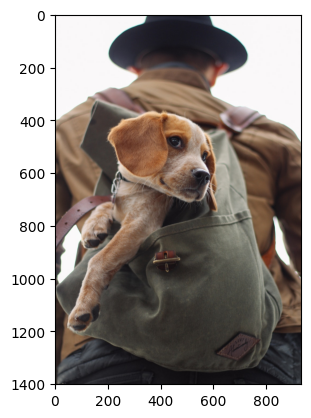

In [18]:
plt.imshow(img1)

In [19]:
large_img = img1
small_img = img2

## Offsets where to start.
x_offset = 0
y_offset = 0

x_end = x_offset + small_img.shape[1]
y_end = y_offset + small_img.shape[0]

In [20]:
large_img[y_offset:y_end,x_offset:x_end] = small_img

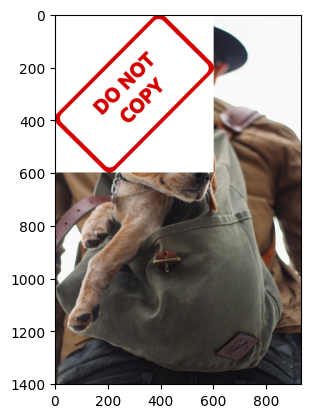

In [21]:
plt.imshow(large_img)

In [22]:
### BLEND TOGETHER IMAGES OF DIFFERENT SIZES.

img1 = cv2.imread('gdrive/My Drive/Datasets/DATA/dog_backpack.png')
print(type(img1))
img1 = cv2.cvtColor(img1,cv2.COLOR_BGR2RGB)
img2 = cv2.imread('gdrive/My Drive/Datasets/DATA/watermark_no_copy.png')
print(type(img2))
img2 = cv2.cvtColor(img2,cv2.COLOR_BGR2RGB)

<class 'numpy.ndarray'>
<class 'numpy.ndarray'>


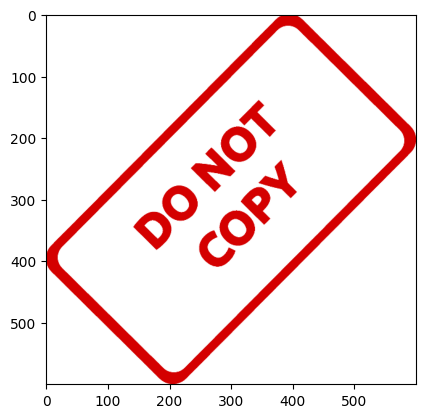

In [23]:
img2 = cv2.resize(img2,(600,600))
plt.imshow(img2)

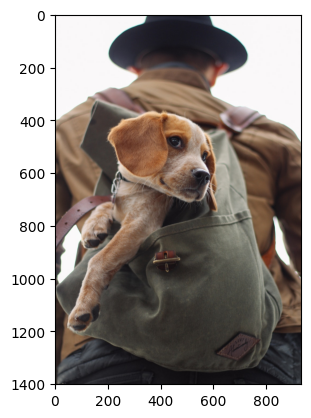

In [24]:
plt.imshow(img1)

In [25]:
img1.shape

(1401, 934, 3)

In [26]:
x_offset = 934 - 600
y_offset = 1401 - 600


In [27]:
img2.shape

(600, 600, 3)

In [28]:
rows,cols,channels = img2.shape

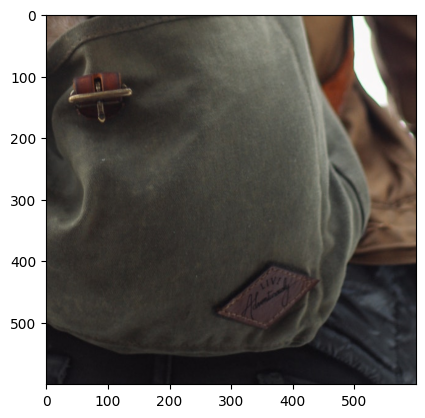

In [29]:
roi = img1[y_offset:1401,x_offset:943]
plt.imshow(roi)

In [30]:
## Mask to grab specific portion.

img2gray = cv2.cvtColor(img2,cv2.COLOR_BGR2GRAY)

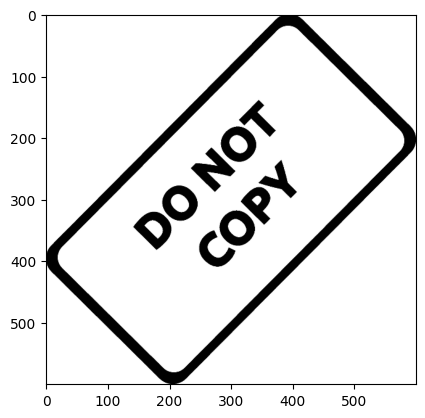

In [31]:
plt.imshow(img2gray,cmap='gray')

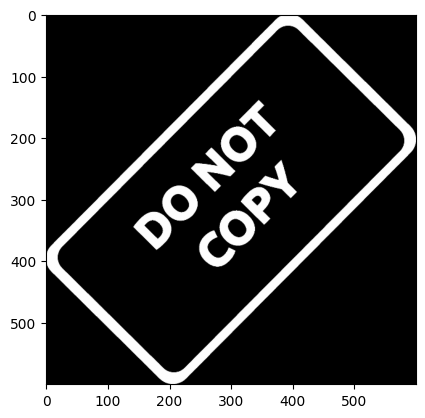

In [32]:
mask_inv = cv2.bitwise_not(img2gray) ## --> inverse of image
plt.imshow(mask_inv,cmap='gray')

In [33]:
mask_inv.shape

(600, 600)

In [34]:
white_background = np.full(img2.shape,255,dtype = np.uint8)  ## add color channel for gray image
white_background.shape

(600, 600, 3)

In [35]:
bk = cv2.bitwise_or(white_background,white_background,mask = mask_inv)

In [36]:
bk.shape

(600, 600, 3)

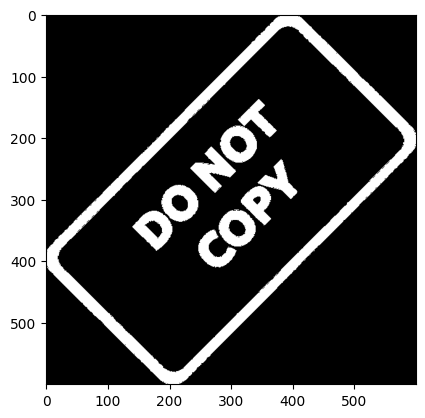

In [37]:
plt.imshow(bk)

In [38]:
fg = cv2.bitwise_or(img2,img2,mask= mask_inv)

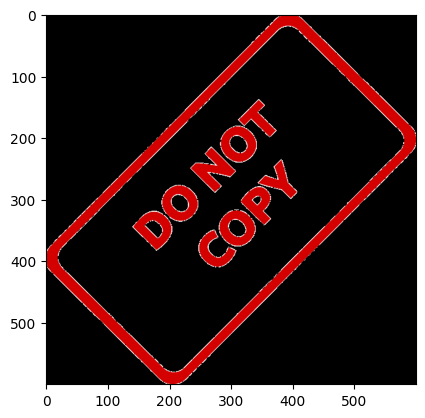

In [39]:
plt.imshow(fg)

In [40]:
final_roi = cv2.bitwise_or(roi,fg)

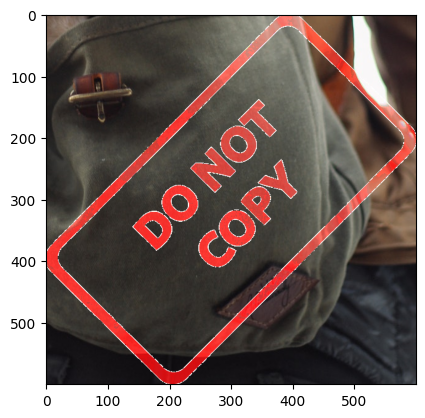

In [41]:
plt.imshow(final_roi)

In [42]:
large_img = img1
small_img = final_roi

In [43]:
large_img[y_offset:y_offset+small_img.shape[0],x_offset:x_offset+small_img.shape[1]] = small_img

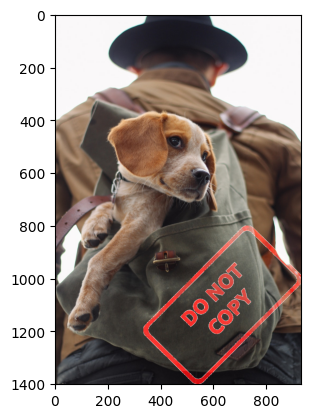

In [44]:
plt.imshow(large_img)

### Image Thresholding

In [45]:
img = cv2.imread('gdrive/My Drive/Datasets/DATA/rainbow.jpg',0)


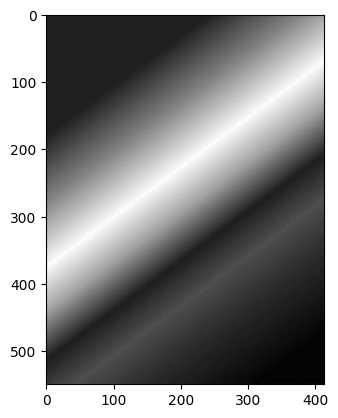

In [46]:
plt.imshow(img,cmap='gray')

In [47]:
ret ,thresh_1 = cv2.threshold(img,127,255,cv2.THRESH_BINARY) ## any value less than 127 becomes 0 and grester than 1 becomes 255
print(ret)

127.0


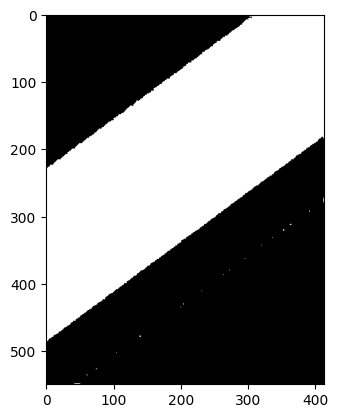

In [48]:
plt.imshow(thresh_1,cmap='gray')

In [49]:
ret ,thresh_2 = cv2.threshold(img,127,255,cv2.THRESH_TRUNC) ## any value less than 127 becomes 0 and grester than 1 becomes 255
print(ret)

127.0


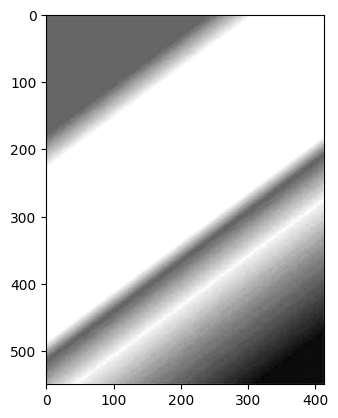

In [50]:
plt.imshow(thresh_2,cmap='gray')

In [51]:
ret ,thresh_3 = cv2.threshold(img,127,255,cv2.THRESH_TOZERO) ## any value less than 127 becomes 0 and grester than 1 becomes 255
print(ret)

127.0


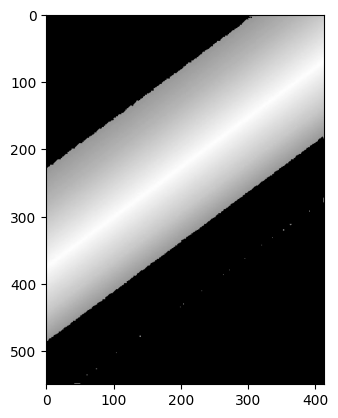

In [52]:
plt.imshow(thresh_3,cmap='gray')

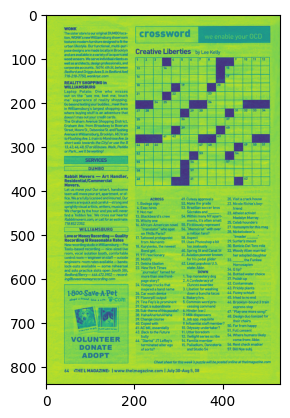

In [53]:
img = cv2.imread('gdrive/My Drive/Datasets/DATA/crossword.jpg',0)
plt.imshow(img)


In [54]:

def show_pic(img):
  fig = plt.figure(figsize=(15,15))
  ax = fig.add_subplot(111)
  ax.imshow(img,cmap='gray')


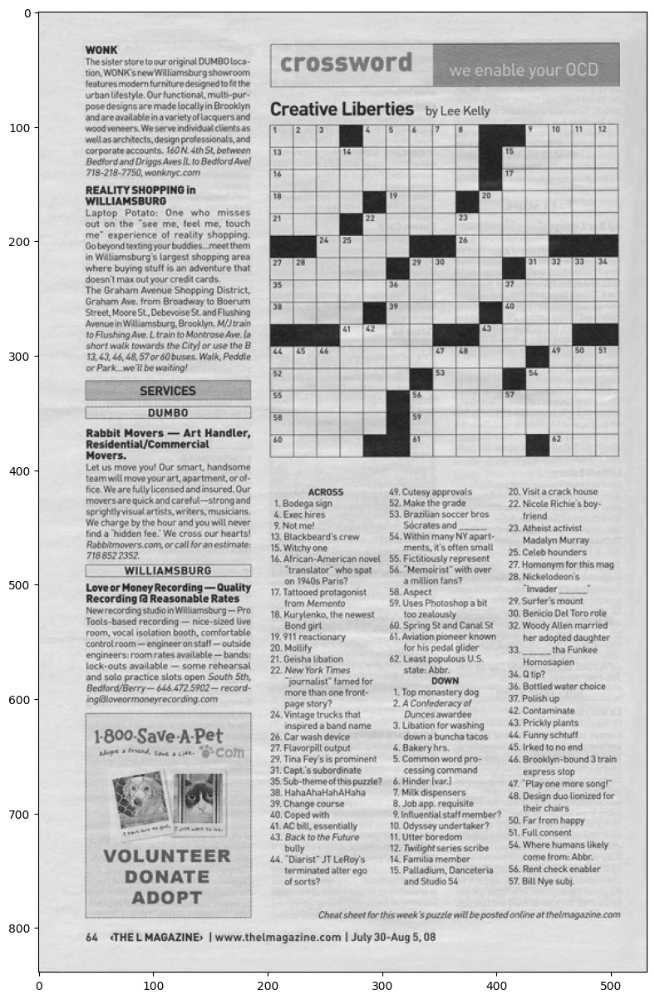

In [55]:
show_pic(img)

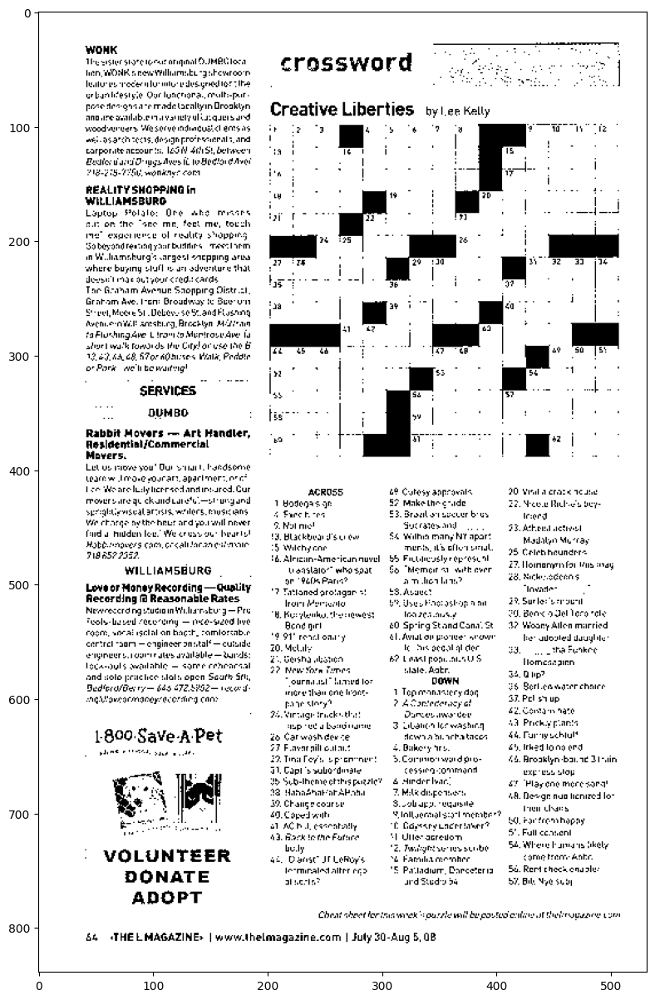

In [56]:
### simple binary threshold

ret,th1 = cv2.threshold(img,127,255,cv2.THRESH_BINARY)
show_pic(th1)

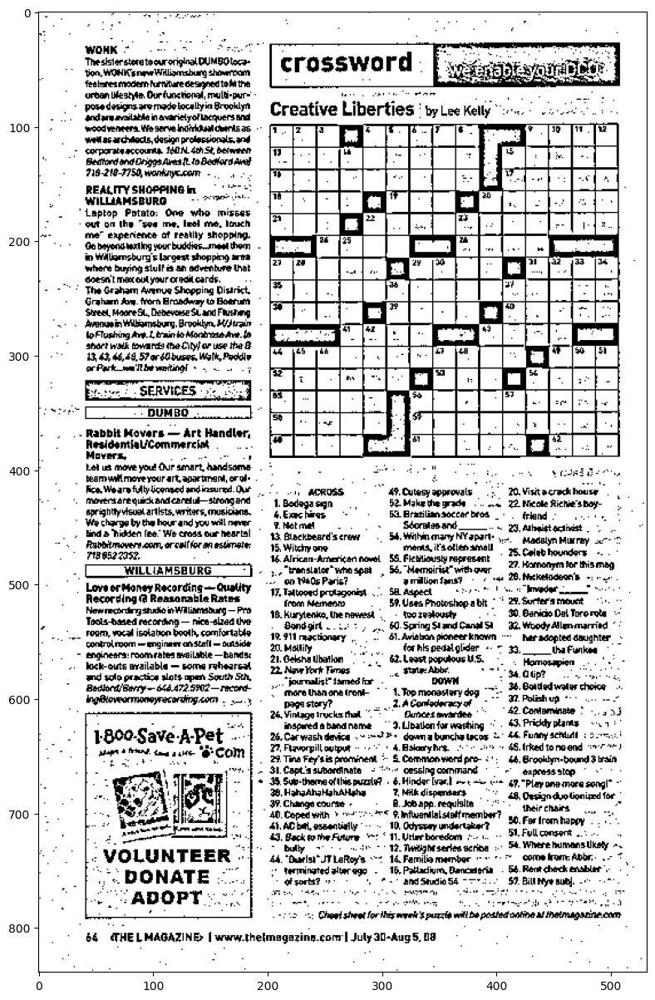

In [57]:
## Adaptive Thresholding

th2 = cv2.adaptiveThreshold(img,255,cv2.ADAPTIVE_THRESH_MEAN_C,cv2.THRESH_BINARY,11,8)
show_pic(th2)


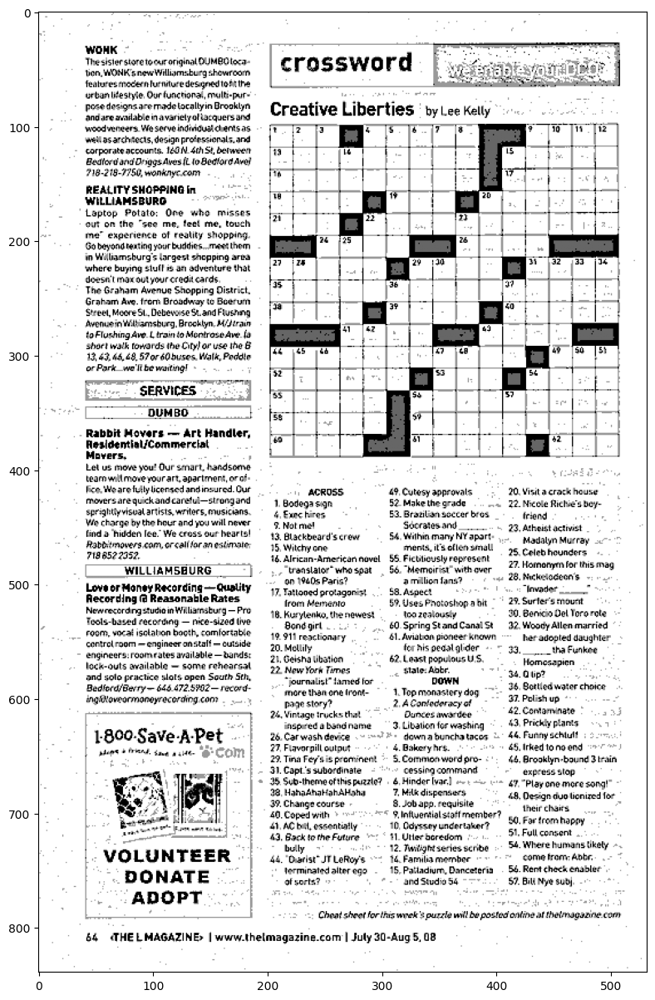

In [58]:
blended = cv2.addWeighted(src1=th1,alpha=0.6,src2=th2,beta =0.4,gamma=0 )
show_pic(blended)

### Blurring and Smoothing

* Blurring and smoothing is one of the most common operation in image prodessing

* It helps to get rid of noise in the image and to help focussing on the general details.

* Blurring is often combined with edge detection, Because edge detection algorithms detect too many edges when they see a high resolution image.


In [59]:
def load_img():
  print("load")

In [60]:
  def load_img():
    img = cv2.imread('gdrive/My Drive/Datasets/DATA/bricks.jpg').astype(np.float32)/255
    img = cv2.cvtColor(img,cv2.COLOR_BGR2RGB)
    return img


In [61]:
def show_pic(img):
  fig = plt.figure(figsize=(12,10))
  ax = fig.add_subplot(111)
  ax.imshow(img)

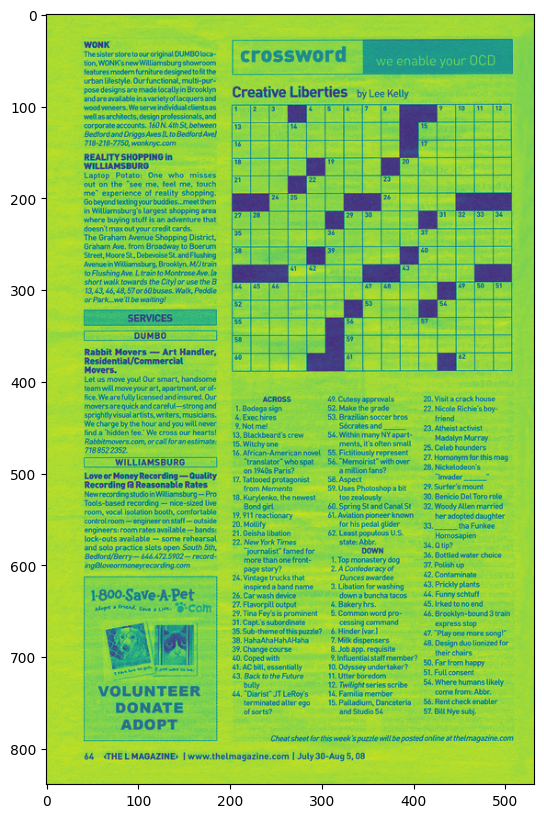

In [62]:
show_pic(img)

In [63]:
gamma = 1/4   ### It is used to control brightness of image
result = np.power(img,gamma)

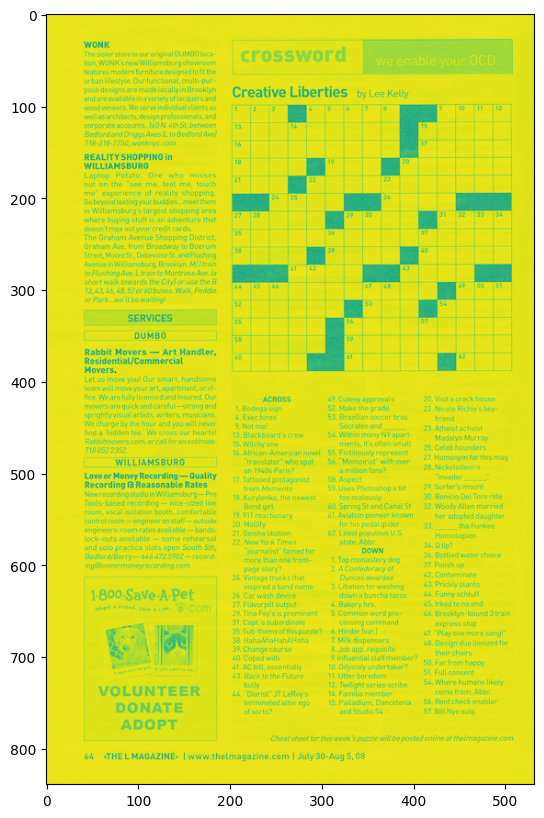

In [64]:
show_pic(result)

In [65]:
### Low pass filter (2D convonutional)
img = load_img()
font = cv2.FONT_HERSHEY_COMPLEX
cv2.putText(img,text='bricks',org = (10,600),fontFace=font,fontScale=10,color=(255,0,0),thickness=4)

array([[[0.78431374, 0.7882353 , 0.80784315],
        [0.7529412 , 0.77254903, 0.79607844],
        [0.7254902 , 0.7647059 , 0.8       ],
        ...,
        [0.7764706 , 0.76862746, 0.7882353 ],
        [0.7764706 , 0.76862746, 0.7882353 ],
        [0.7764706 , 0.76862746, 0.7882353 ]],

       [[0.8784314 , 0.88235295, 0.9019608 ],
        [0.7647059 , 0.78431374, 0.80784315],
        [0.7019608 , 0.7529412 , 0.78431374],
        ...,
        [0.7764706 , 0.76862746, 0.7882353 ],
        [0.7764706 , 0.76862746, 0.7882353 ],
        [0.7764706 , 0.76862746, 0.7882353 ]],

       [[0.85490197, 0.8666667 , 0.89411765],
        [0.6509804 , 0.6784314 , 0.70980394],
        [0.4862745 , 0.5372549 , 0.57254905],
        ...,
        [0.7764706 , 0.76862746, 0.7882353 ],
        [0.7764706 , 0.76862746, 0.7882353 ],
        [0.7764706 , 0.76862746, 0.7882353 ]],

       ...,

       [[0.8509804 , 0.83137256, 0.84705883],
        [0.84705883, 0.827451  , 0.84313726],
        [0.84313726, 0

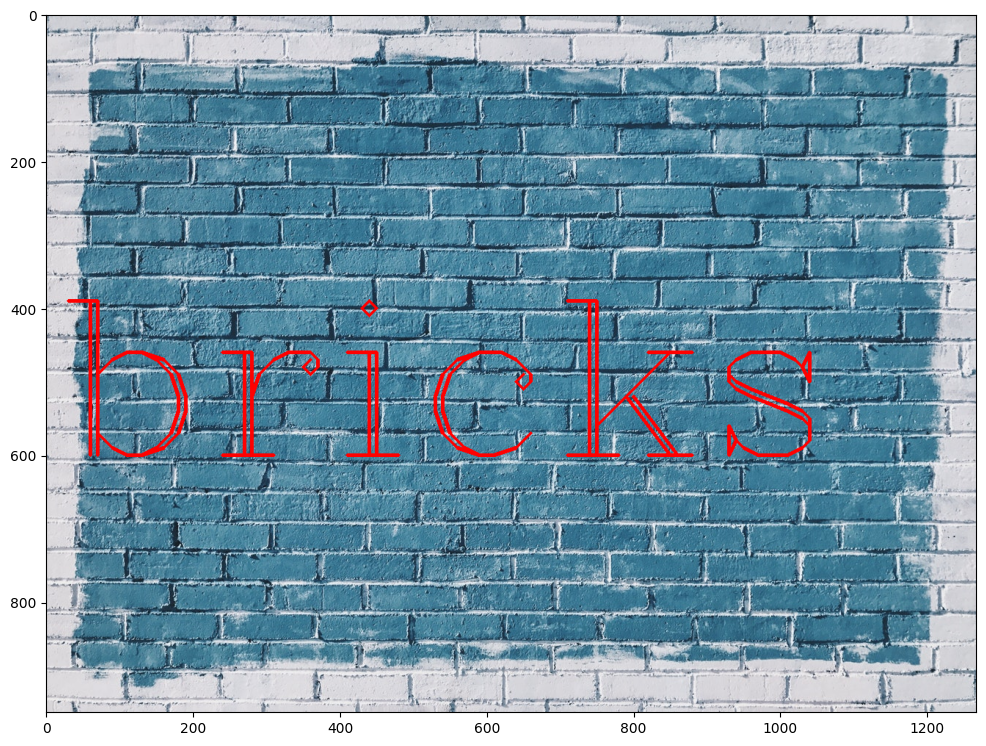

In [66]:
show_pic(img)

In [67]:
### Kernel setup for low pass filter

kernal = np.ones(shape=(5,5),dtype=np.float32)/25
kernal

array([[0.04, 0.04, 0.04, 0.04, 0.04],
       [0.04, 0.04, 0.04, 0.04, 0.04],
       [0.04, 0.04, 0.04, 0.04, 0.04],
       [0.04, 0.04, 0.04, 0.04, 0.04],
       [0.04, 0.04, 0.04, 0.04, 0.04]], dtype=float32)

In [68]:
### syntax for 2d filter
dst = cv2.filter2D(img,-1,kernal)  ## -1 is desired depth means we the output depth same as the output depth.

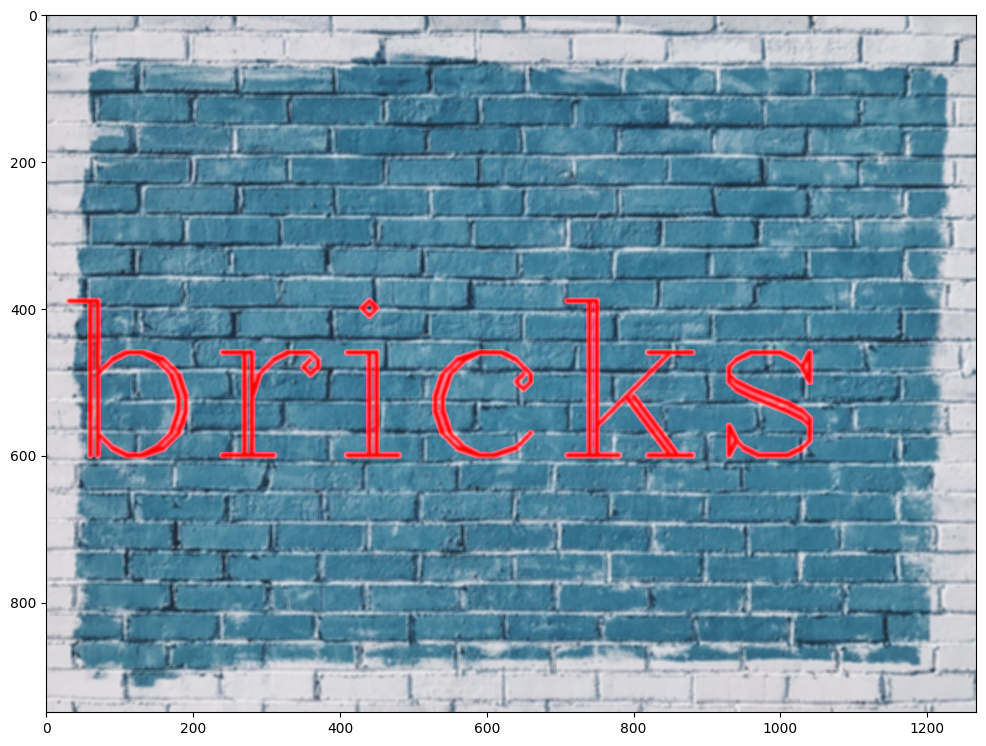

In [69]:
show_pic(dst)  ## It is little bit blurred.


In [70]:
img = load_img()
font = cv2.FONT_HERSHEY_COMPLEX
cv2.putText(img,text='bricks',org = (10,600),fontFace=font,fontScale=10,color=(255,0,0),thickness=4)
print('reset')

reset


In [71]:
bluured = cv2.blur(img,(10,10))

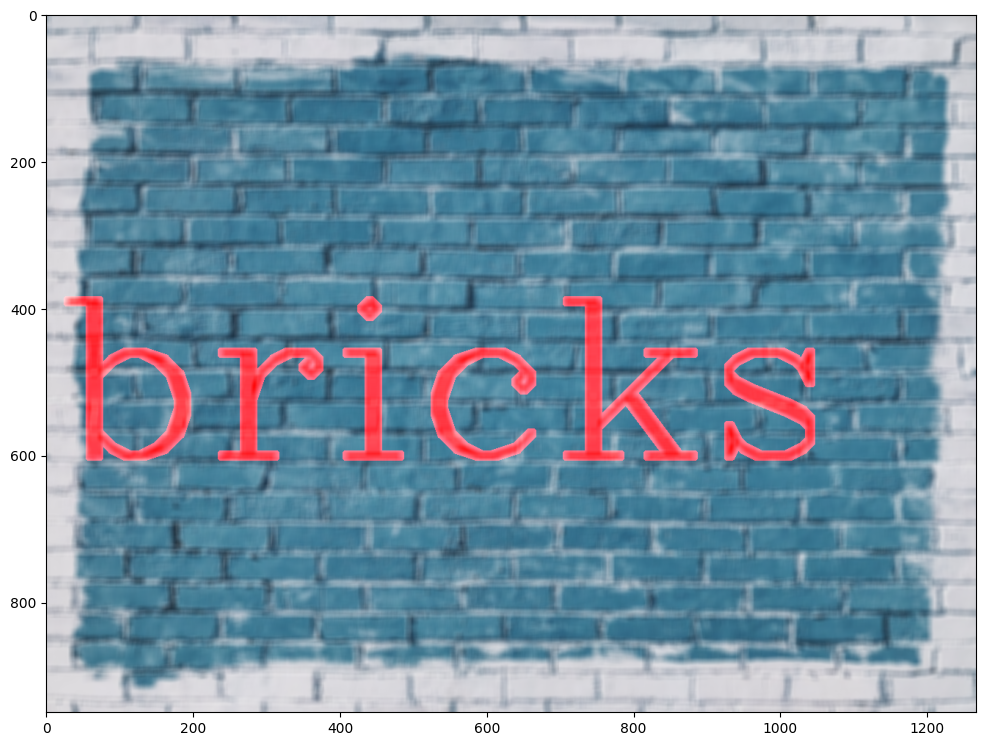

In [72]:
show_pic(bluured)

In [73]:
## Guassian Blur
## Median Filter

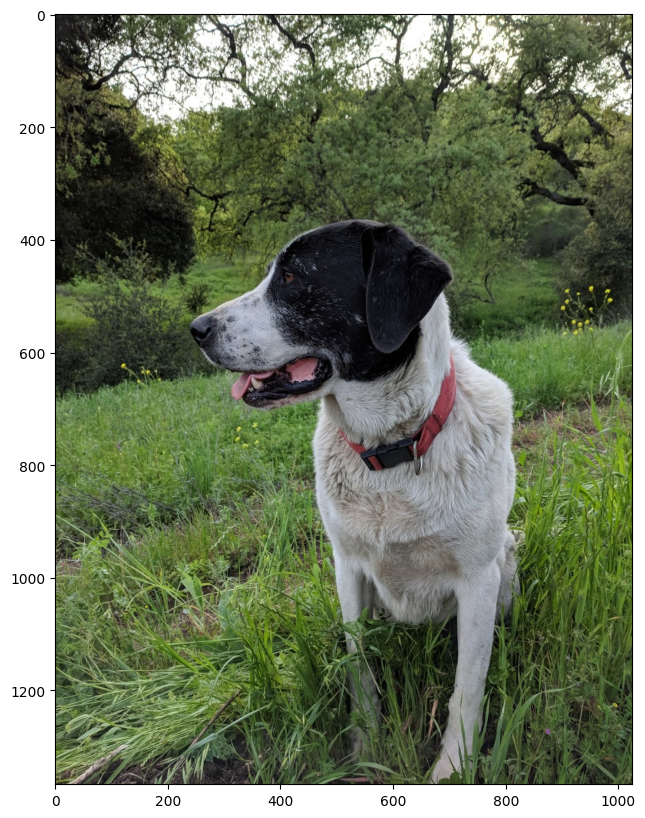

In [74]:
img = cv2.imread('gdrive/My Drive/Datasets/DATA/sammy.jpg').astype(np.float32)/255
img = cv2.cvtColor(img,cv2.COLOR_BGR2RGB)
show_pic(img)



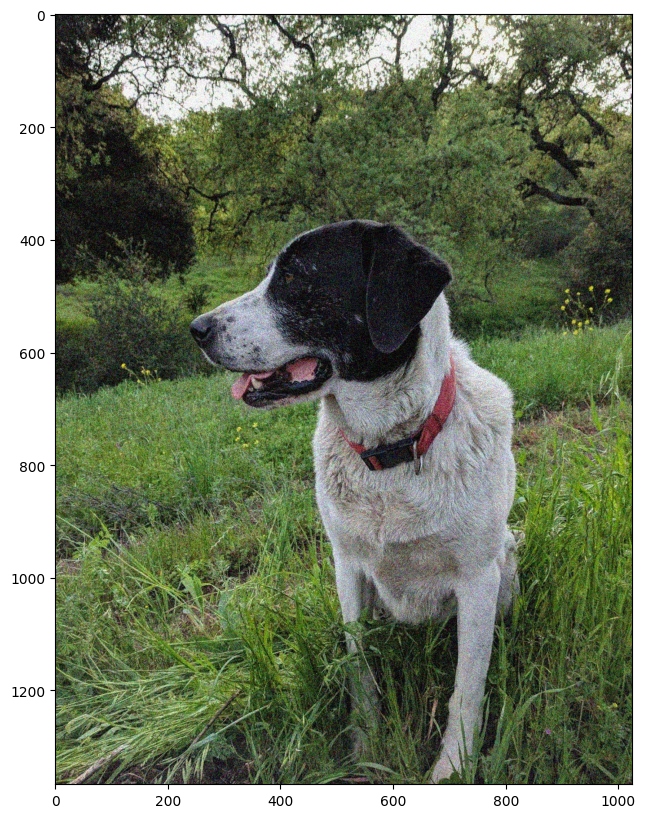

In [75]:
noise_img = cv2.imread('gdrive/My Drive/Datasets/DATA/sammy_noise.jpg').astype(np.float32)/255
show_pic(noise_img)

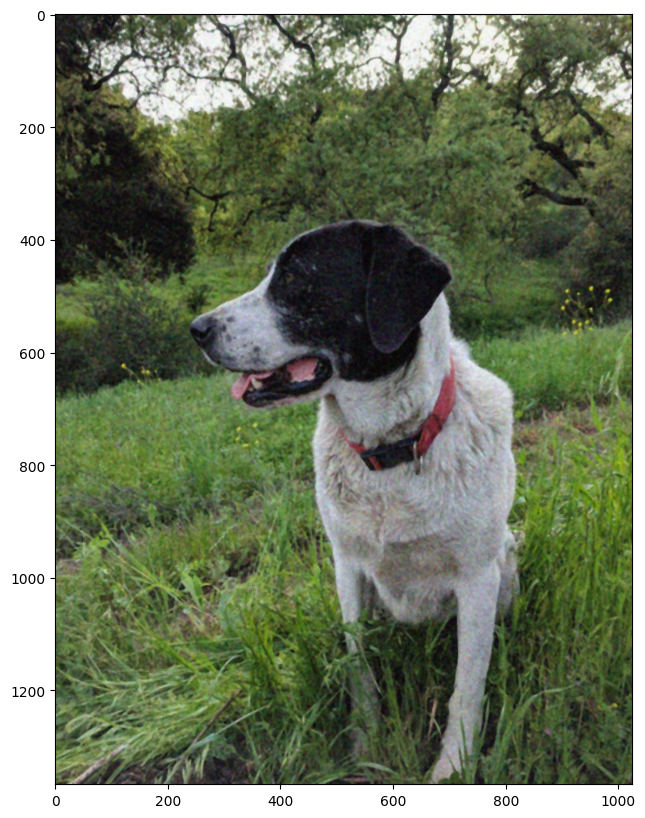

In [76]:
median = cv2.medianBlur(noise_img,5)  #--> 5 is the kernal sie
show_pic(median)   ### median blur is also used to get rid of noise.

In [77]:
###
## BilateralFilter.

### Morphological Operators
* These are the kernels which can achieve variety of effects such as reducing noise

* Certain operators are very to remove balck points on a white background and vice versa.

* Others operators can also achieve an erosion and dilation effect that can add or erode from an existing image


In [78]:
def load_img1():
  blank_img = np.zeros((600,600))
  font = cv2.FONT_HERSHEY_COMPLEX
  cv2.putText(blank_img,text='ABCDE',org=(50,300),fontFace=font,fontScale=5,color=(255,255,255),thickness=10)
  return blank_img

In [79]:
def display(img):
  fig = plt.figure(figsize=(12,10))
  ax = fig.add_subplot(111)
  ax.imshow(img,cmap='gray')

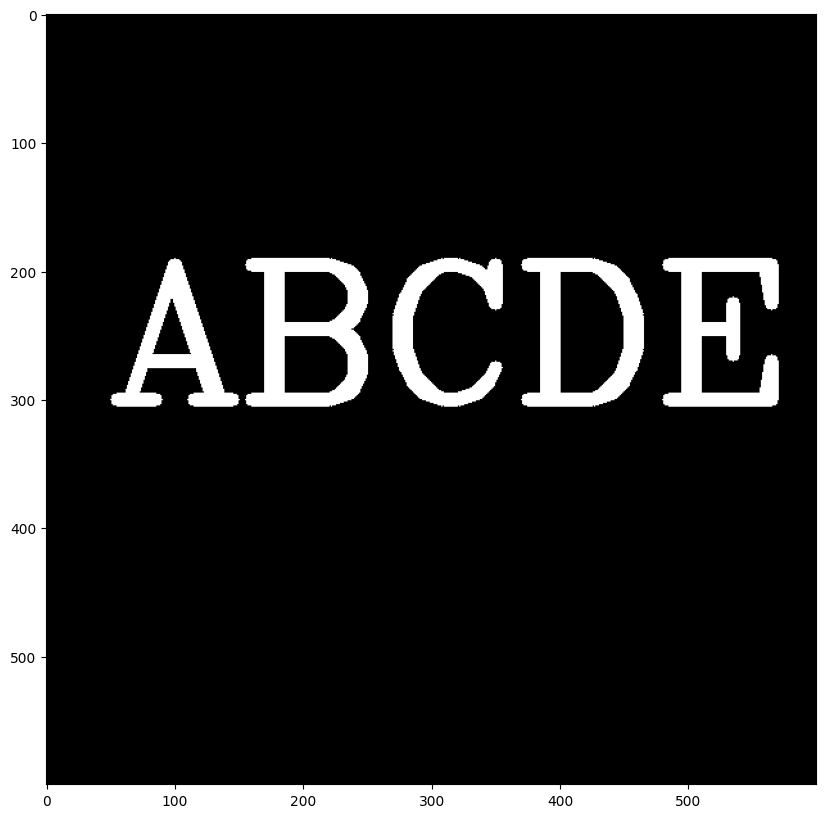

In [80]:
img = load_img1()
display(img)

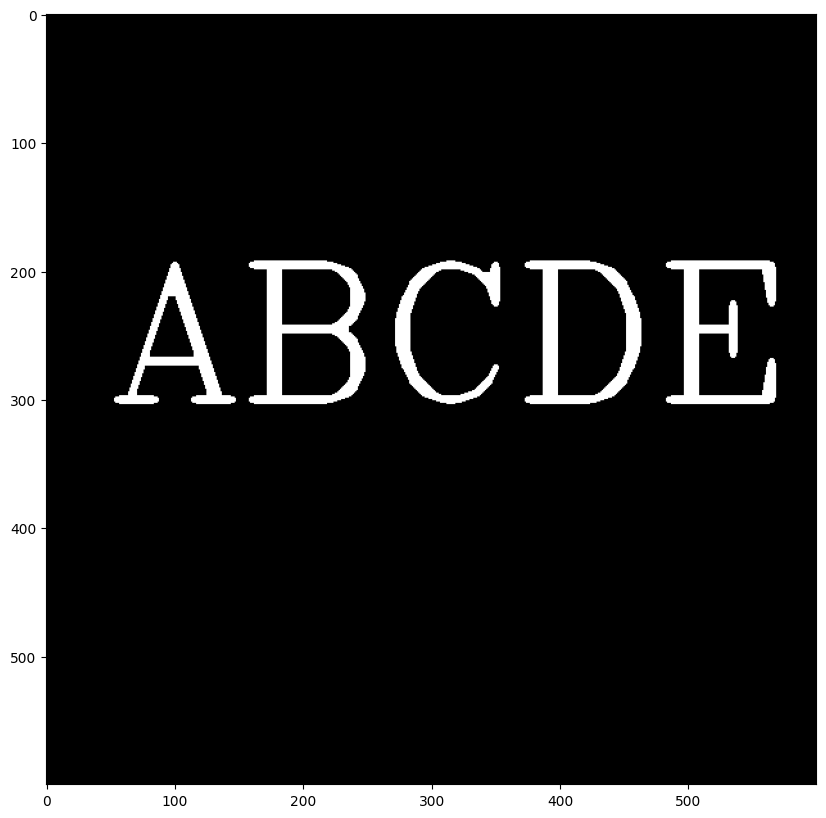

In [81]:
## Erosion
## erose boundries of foreground

kernel = np.ones((5,5),dtype=np.uint8)
eroded = cv2.erode(img,kernel,iterations=1) ## iterations passes to be done
display(eroded)

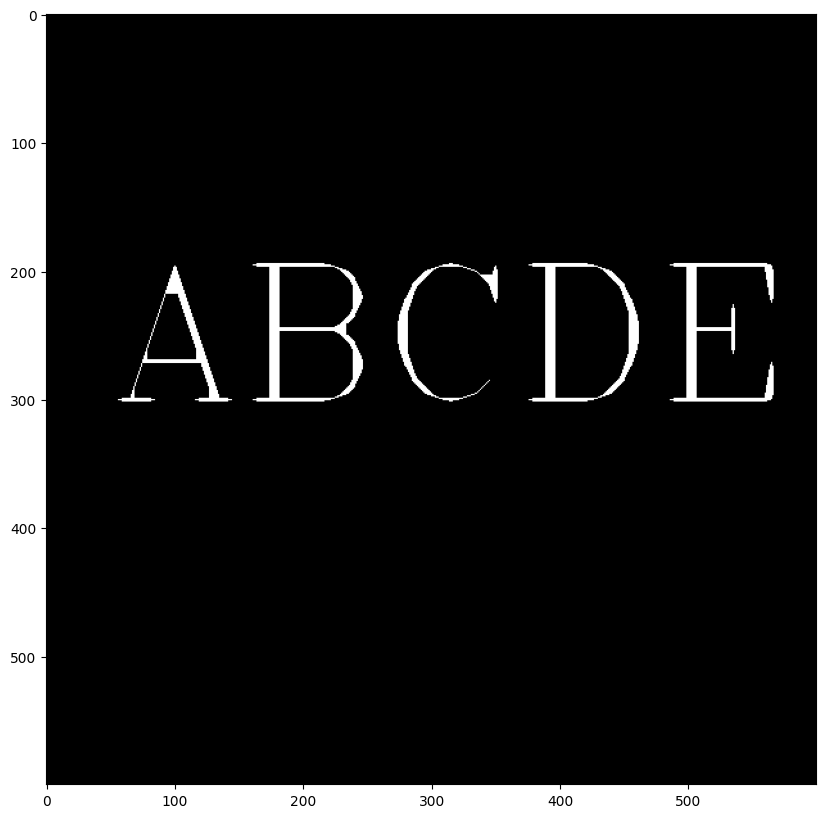

In [82]:
## Erosion
## erose boundries of foreground

kernel = np.ones((5,5),dtype=np.uint8)
eroded = cv2.erode(img,kernel,iterations=2) ## iterations passes to be done
display(eroded)

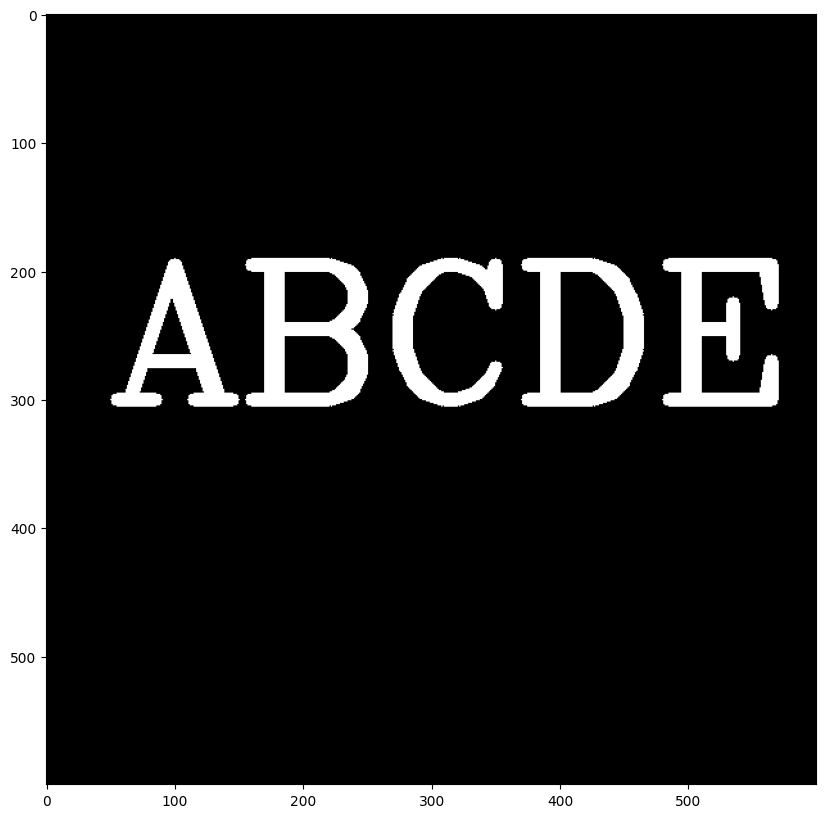

In [83]:
## opening
## opening is erosion followed by dilution --> have to learn about it

img = load_img1()
display(img)

In [84]:
white_noise = np.random.randint(0,2,size=(600,600))
# show_pic(white_noise)

In [85]:
img.max()

np.float64(255.0)

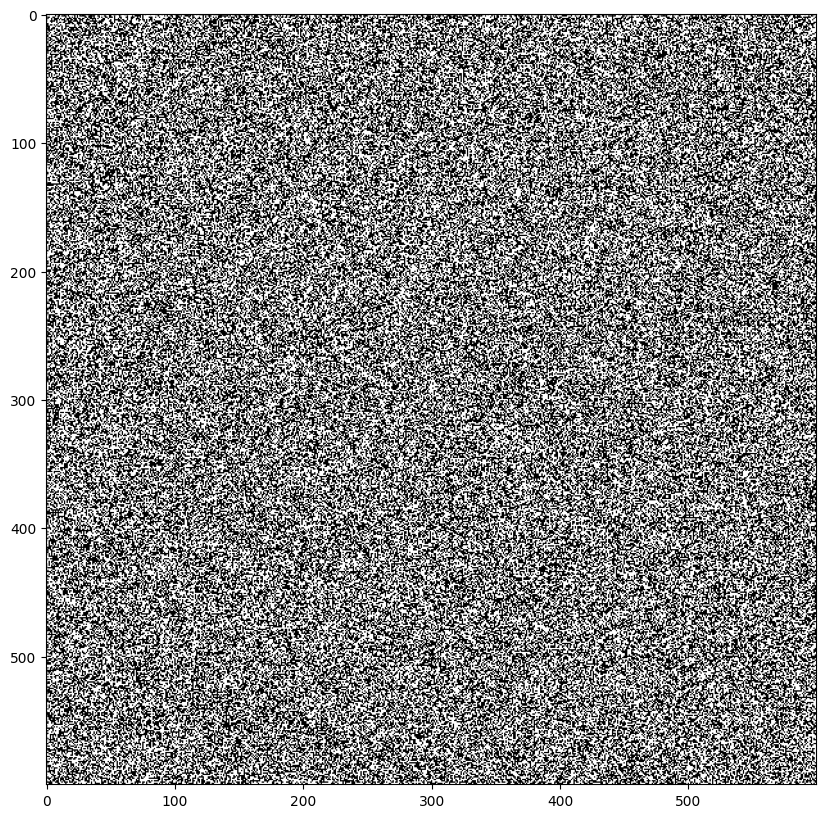

In [86]:
## we have to convert our white noise img into 0 to 255

white_noise = white_noise*255
display(white_noise)

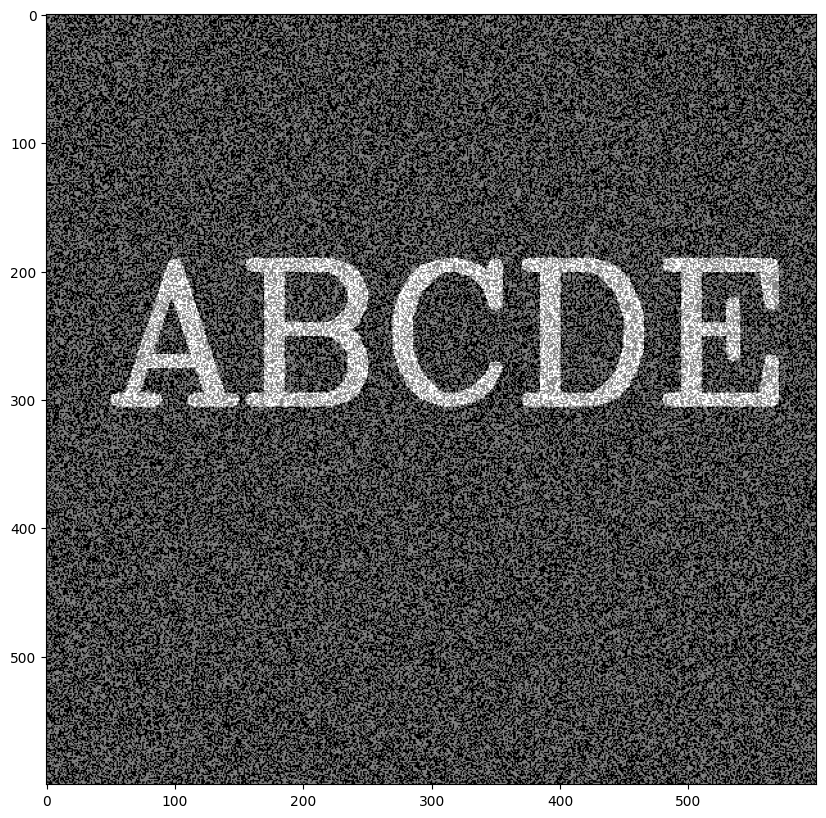

In [87]:
noise_img = white_noise + img
display(noise_img)

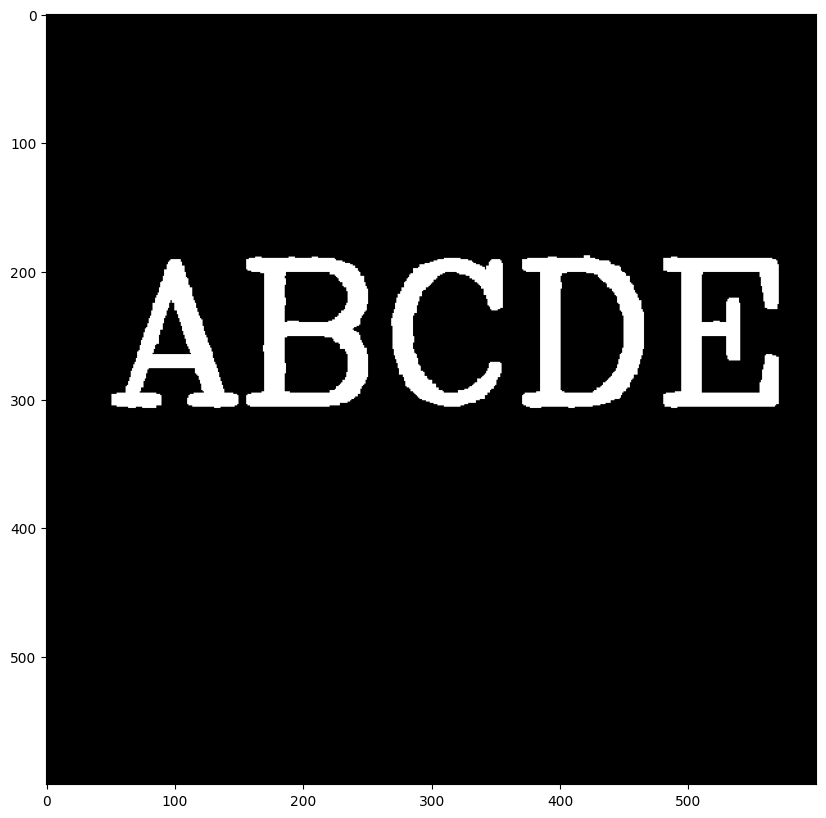

In [88]:
opening = cv2.morphologyEx(noise_img,cv2.MORPH_OPEN,kernel)
display(opening)

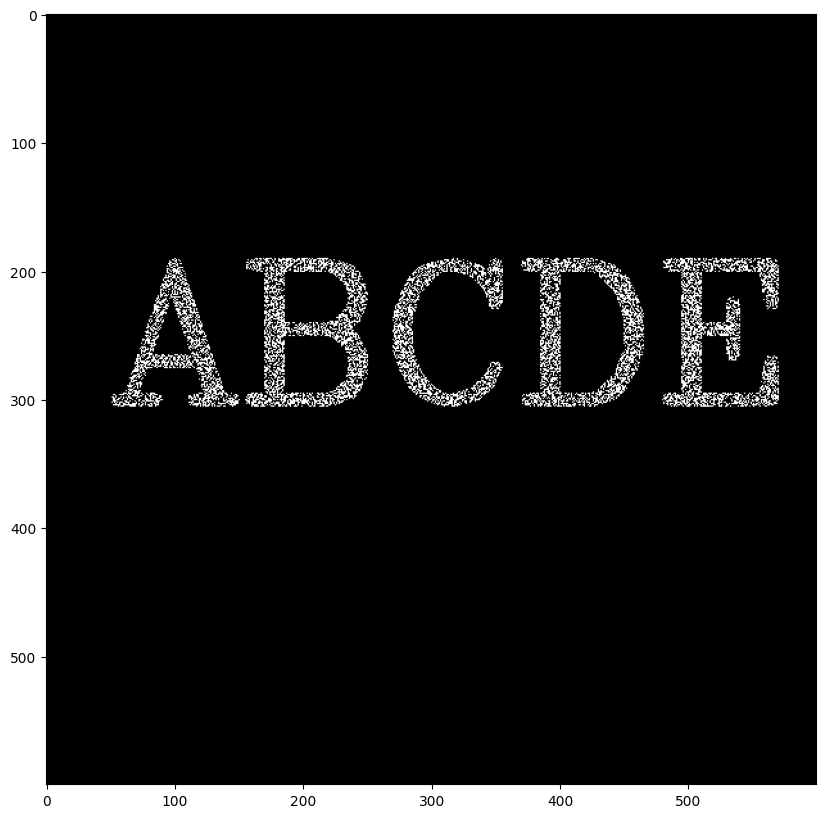

In [89]:
img = load_img1()
black_noise = np.random.randint(0,2,size=(600,600))
black_noise = black_noise * -255
black_noise_img = black_noise + img
black_noise_img[black_noise_img == -255]= 0
display(black_noise_img)

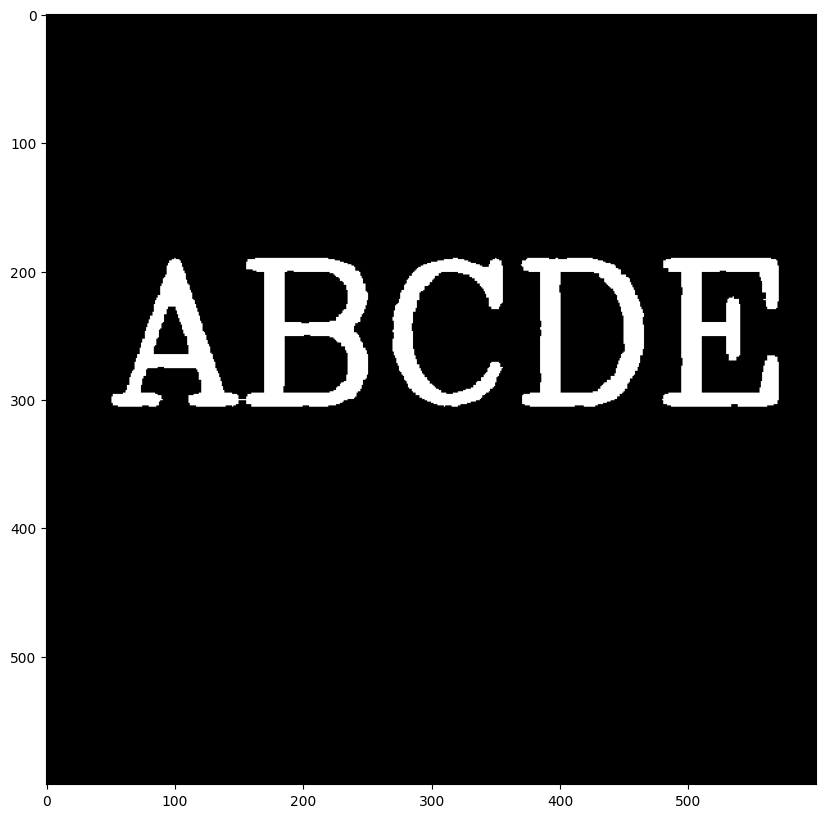

In [90]:
 ## Closing is used to remove noise in the foreground part of image.

closing = cv2.morphologyEx(black_noise_img,cv2.MORPH_CLOSE,kernel)
display(closing)

In [91]:
## morphological Gradient

## It takes difference oof dilation

img = load_img1()


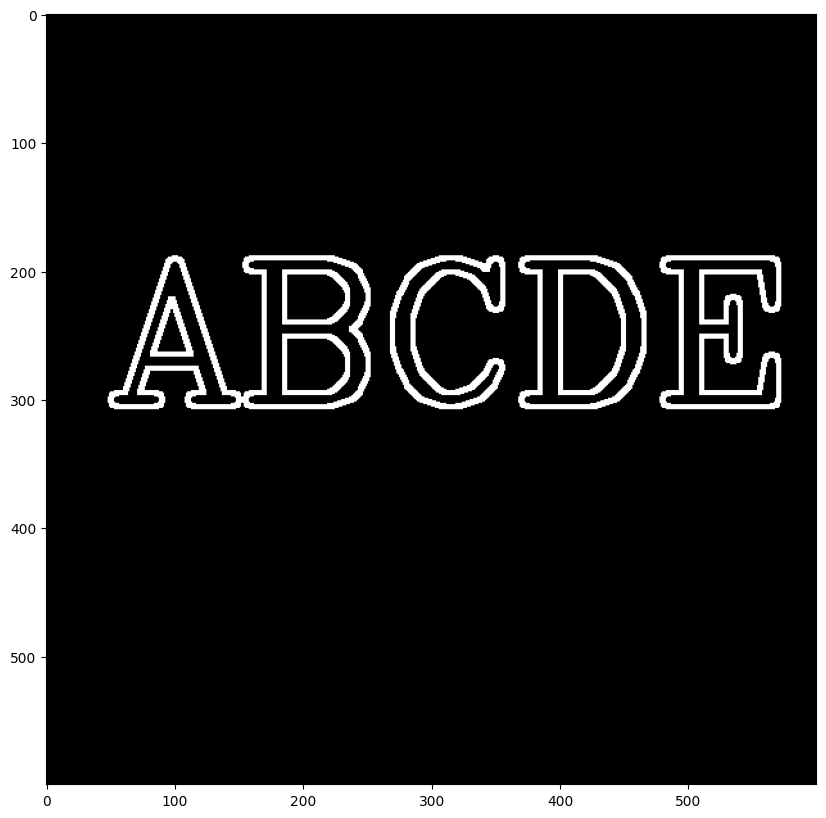

In [92]:
gradient = cv2.morphologyEx(img,cv2.MORPH_GRADIENT,kernel)
display(gradient)

### Gradient
* It is a directional change in the intensity or color in an image

* Gradients can be calculated in specific direction

* Note I have to explain these through images examples not just text.



In [93]:
def display_image(img):
  fig = plt.figure(figsize=(12,10))
  ax = fig.add_subplot(111)
  ax.imshow(img,cmap='gray')

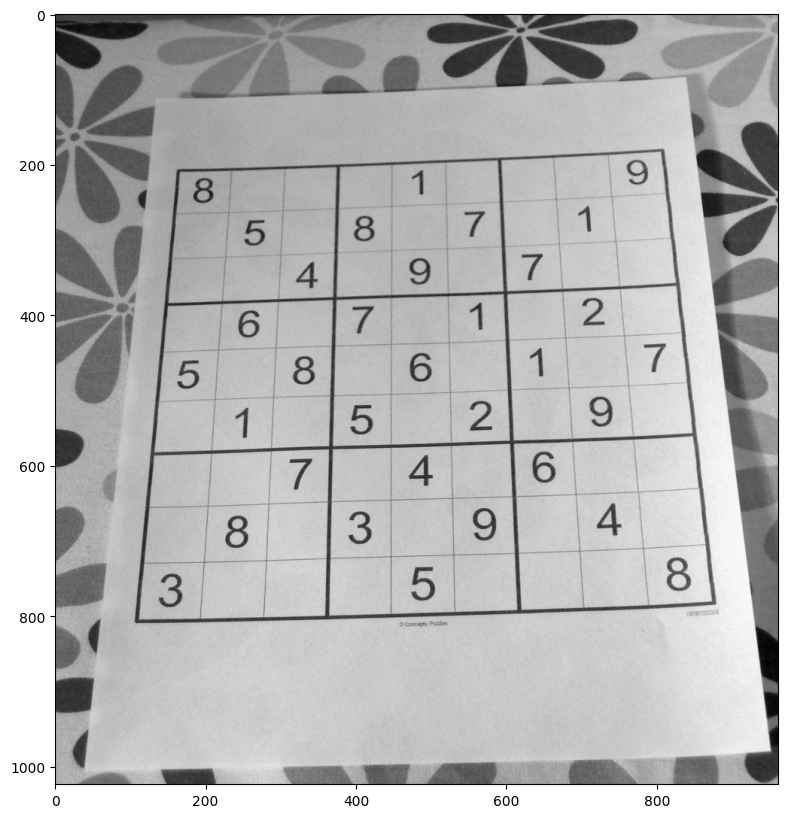

In [94]:
img = cv2.imread('gdrive/My Drive/Datasets/DATA/sudoku.jpg',0) # 0 parameter to read in gray scale.
display_image(img)

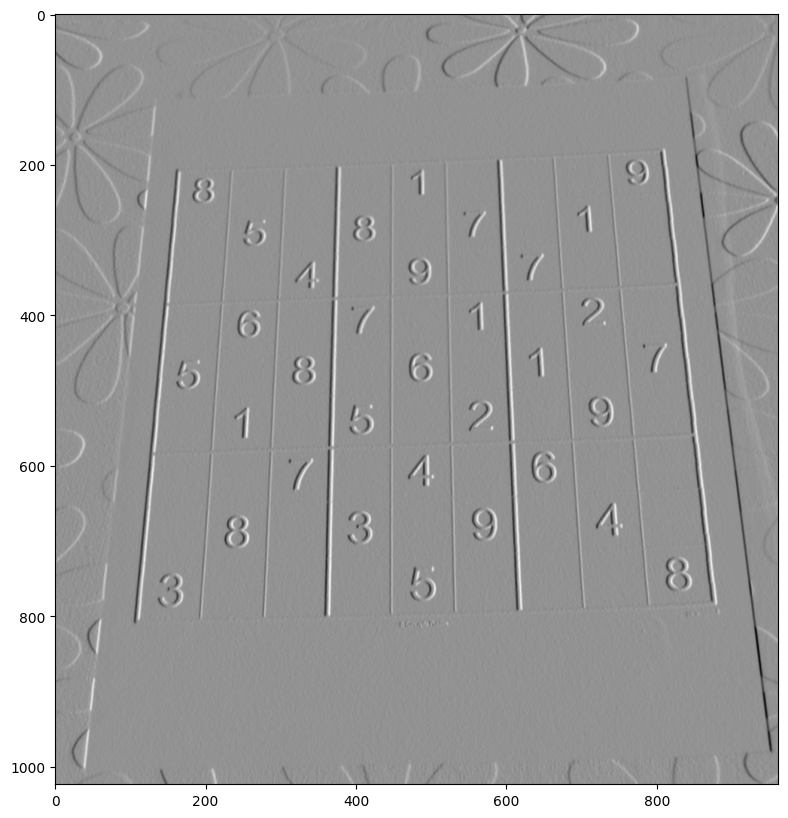

In [96]:
# dx is 1 because we are calculating x derivative
sobel_x = cv2.Sobel(img,ddepth=cv2.CV_64F,dx=1,dy=0,ksize=5) ## depth is precision of each pixel
display_image(sobel_x)

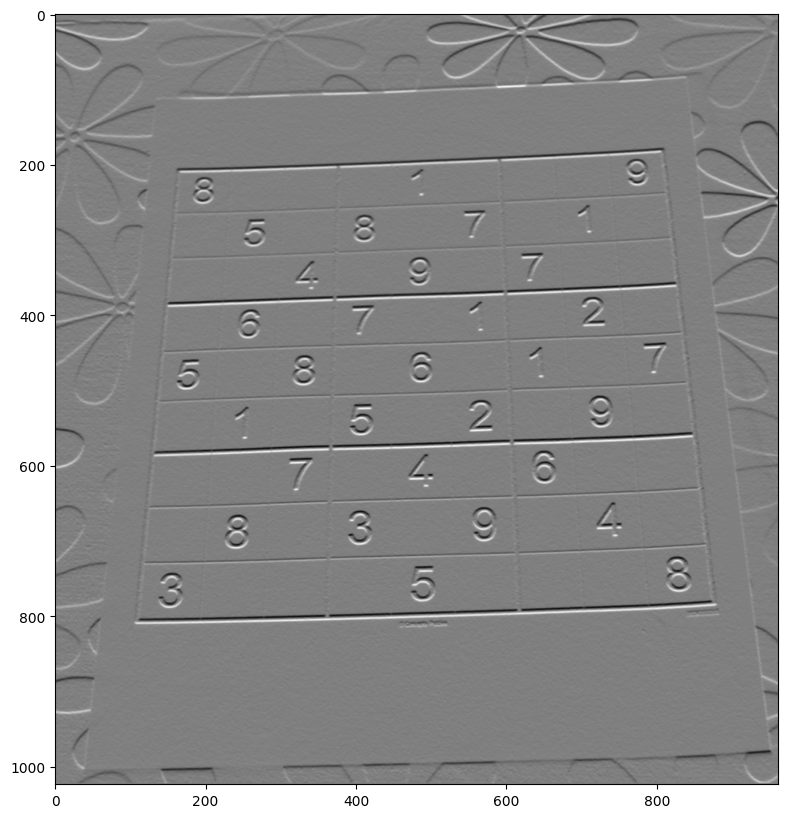

In [97]:
sobel_y = cv2.Sobel(img,ddepth=cv2.CV_64F,dx=0,dy=1,ksize=5) ## depth is precision of each pixel
display_image(sobel_y)

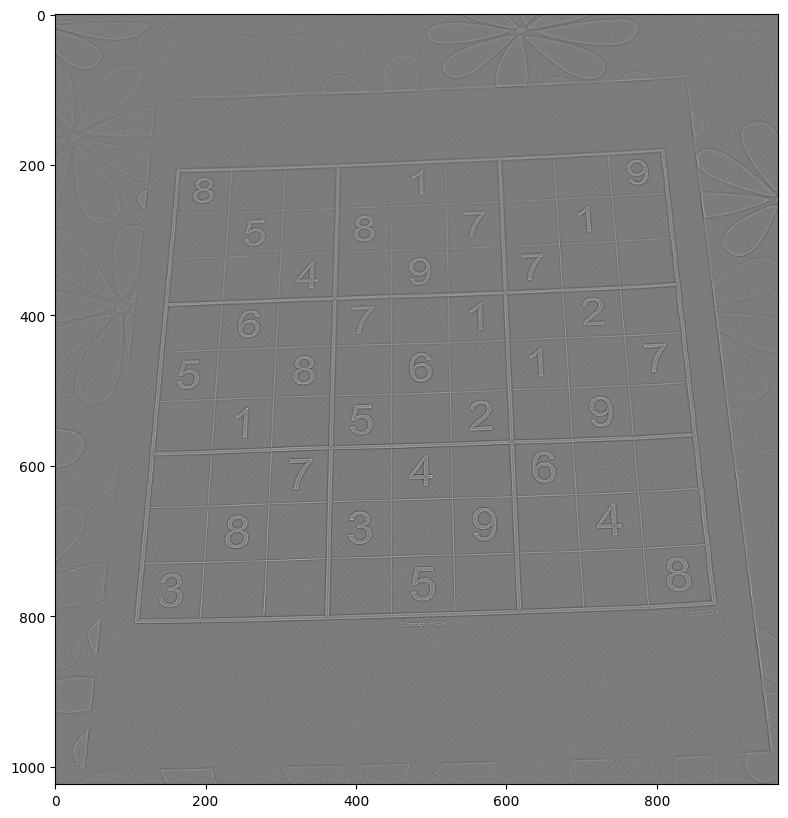

In [98]:
## laplacian derivatives
laplacian = cv2.Laplacian(img,ddepth=cv2.CV_64F)
display_image(laplacian)
#

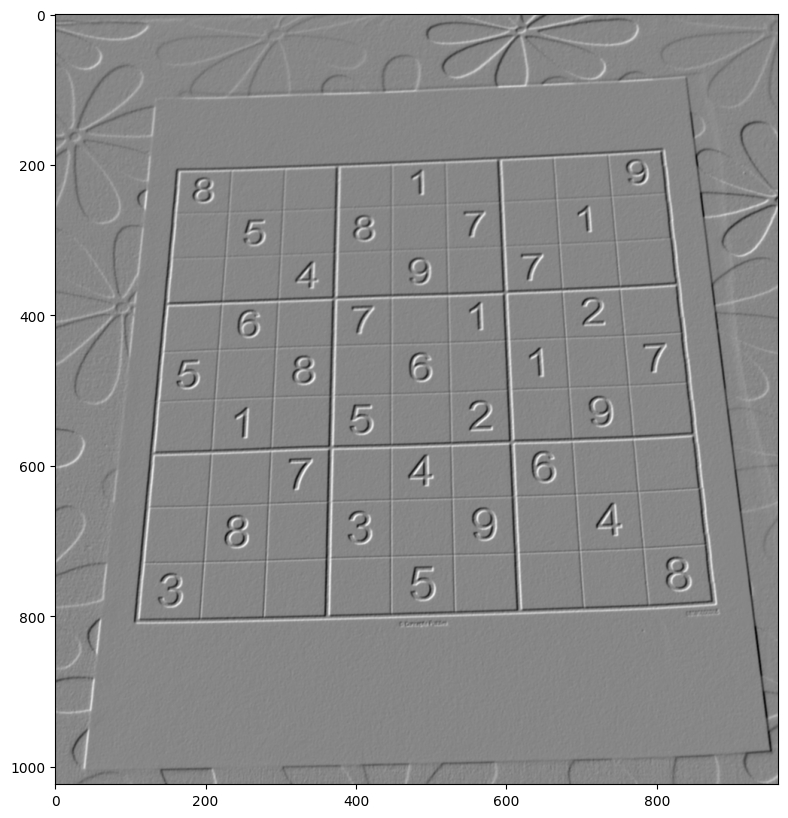

In [99]:
###
blended = cv2.addWeighted(src1=sobel_x,alpha=0.6,src2=sobel_y,beta =0.4,gamma=0)
display_image(blended)

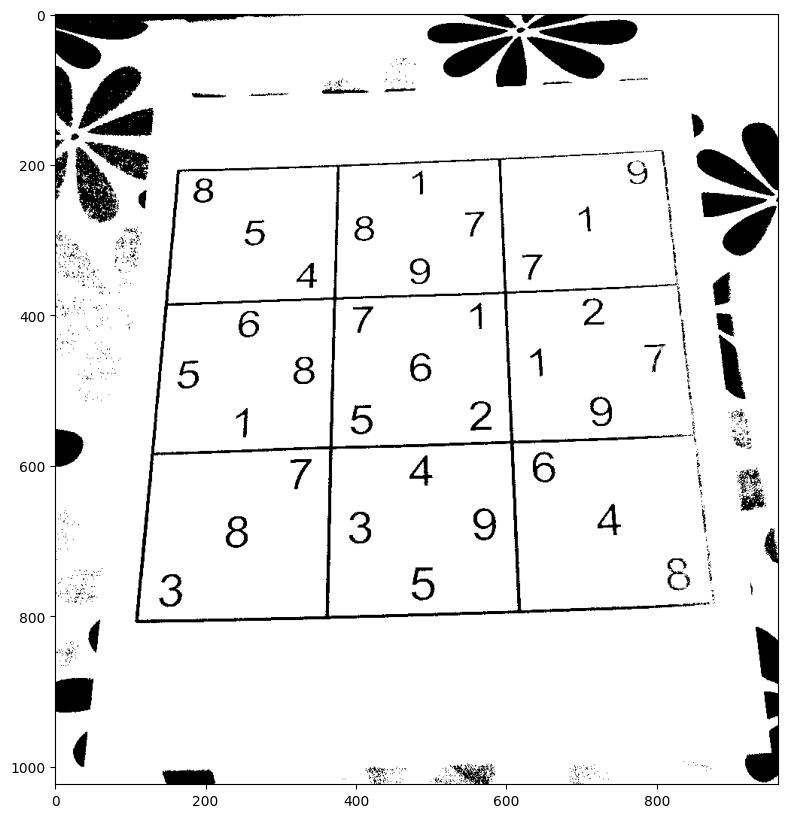

In [100]:
ret ,th1 = cv2.threshold(img,100,255,cv2.THRESH_BINARY)
display_image(th1)

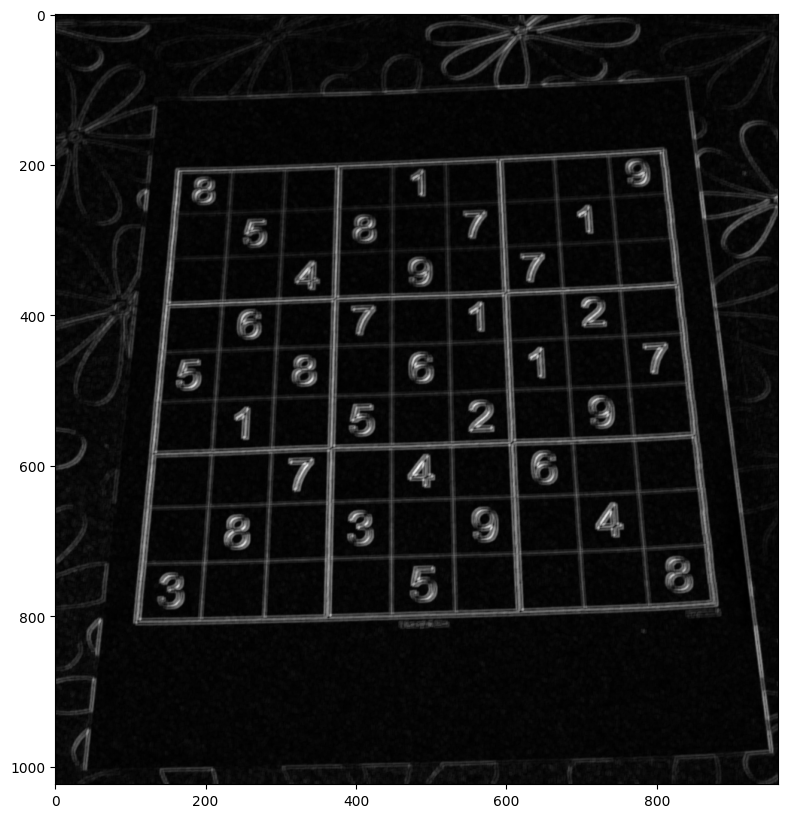

In [101]:
### Morphological Gradient
kernel = np.ones((4,4),dtype=np.uint8)
gradient = cv2.morphologyEx(blended,cv2.MORPH_GRADIENT,kernel)
display_image(gradient)

### Hostograms

* A histogram is a visual representation of the distribution of a continuous feature

* For images,we can display the frequency of values for colors.
* Each of the three RGB channels has values between 0-255
^ We can plot these as histograms on top of each other to see how much of each channel there is.

In [104]:
dark_horse = cv2.imread('gdrive/My Drive/Datasets/DATA/horse.jpg') ## Original BRG OPENCV
show_horse = cv2.cvtColor(dark_horse,cv2.COLOR_BGR2RGB)  ## CONVERTED RGB FOR SHOW

rainbow = cv2.imread('gdrive/My Drive/Datasets/DATA/rainbow.jpg')
show_rainbow = cv2.cvtColor(rainbow,cv2.COLOR_BGR2RGB)

blue_bricks = cv2.imread('gdrive/My Drive/Datasets/DATA/bricks.jpg')
show_bricks = cv2.cvtColor(blue_bricks,cv2.COLOR_BGR2RGB)

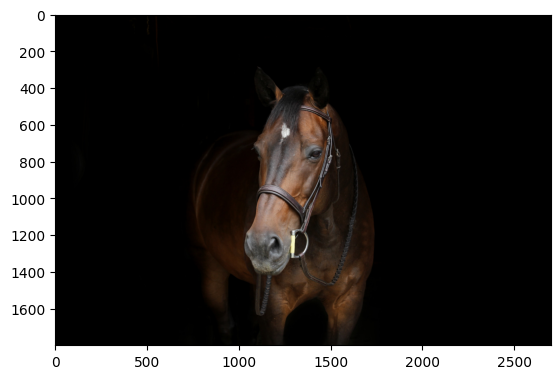

In [105]:
plt.imshow(show_horse)

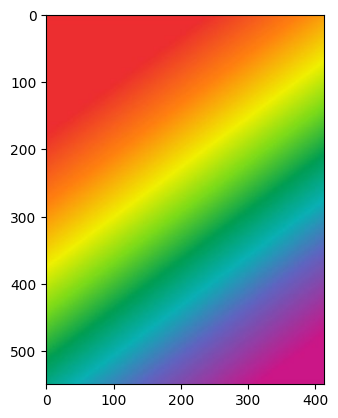

In [106]:
plt.imshow(show_rainbow)

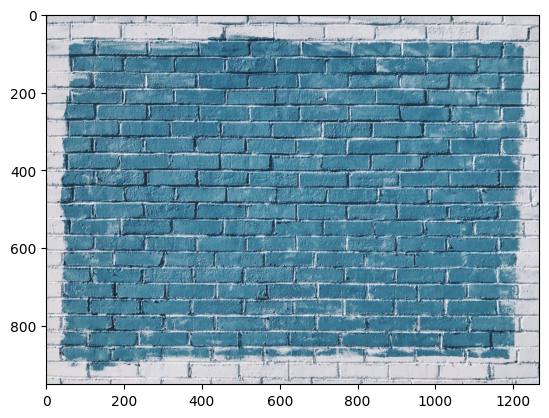

In [107]:
plt.imshow(show_bricks)

In [108]:
hist_values = cv2.calcHist(images=[blue_bricks],channels=[0],mask=None,histSize=[256],ranges=[0,256])
hist_values.shape

(256, 1)

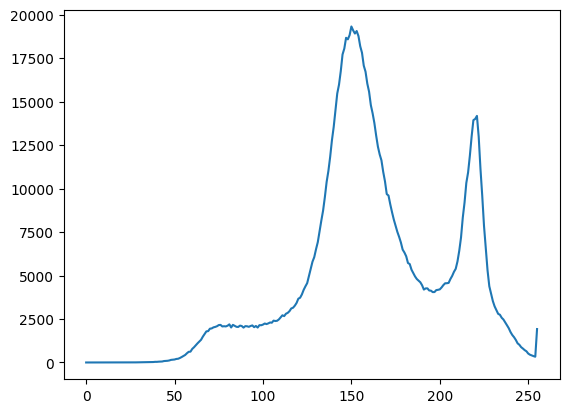

In [109]:
plt.plot(hist_values)

In [110]:
hist_values = cv2.calcHist(images=[dark_horse],channels=[0],mask=None,histSize=[256],ranges=[0,256])
hist_values.shape

(256, 1)

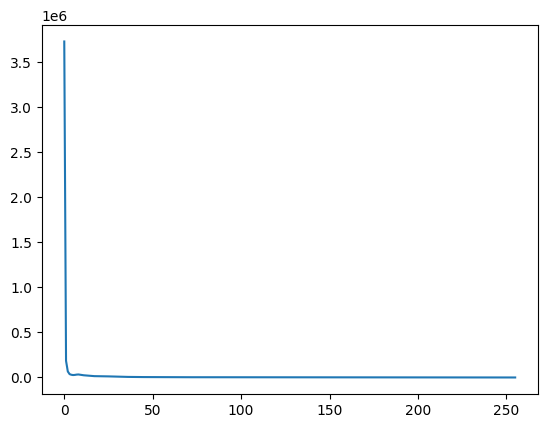

In [111]:
plt.plot(hist_values)

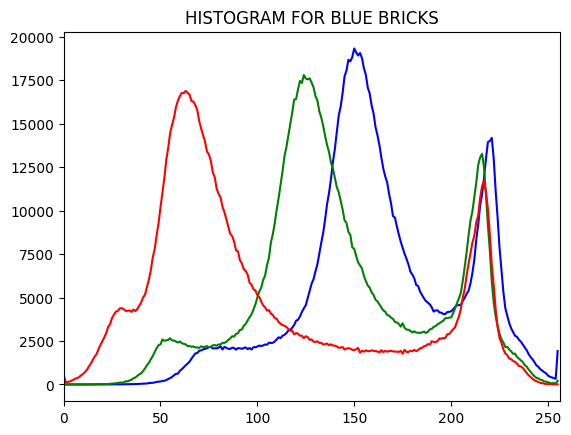

In [112]:
img = blue_bricks
color = ('b','g','r')
for i,col in enumerate(color):
  histr = cv2.calcHist([img],[i],None,[256],[0,256])
  plt.plot(histr,color=col)
  plt.xlim([0,256])

plt.title("HISTOGRAM FOR BLUE BRICKS")
plt.show()

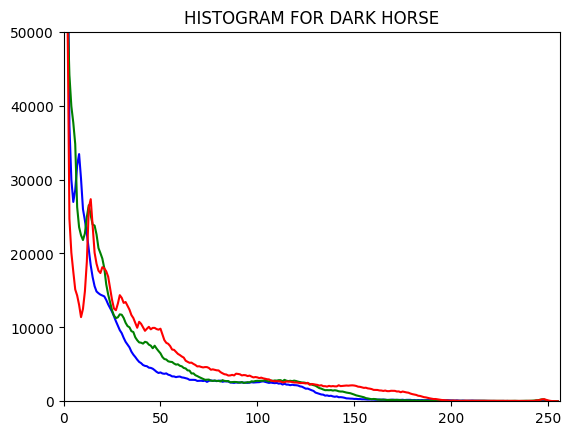

In [116]:
img = dark_horse
color = ('b','g','r')
for i,col in enumerate(color):
  histr = cv2.calcHist([img],[i],None,[256],[0,256])
  plt.plot(histr,color=col)
  plt.xlim([0,256])
  plt.ylim([0,50000])

plt.title("HISTOGRAM FOR DARK HORSE")
plt.show()

### Histogram Equalization

* It is method of contrast adjustment based on the images's histogram

* We can increase or decrease the contrast of image through histogram equalization

* Applying the histogram equalization will reduce the color depth.

* We more focus o commulative histogram.

In [117]:

rainbow = cv2.imread('gdrive/My Drive/Datasets/DATA/rainbow.jpg')
show_rainbow = cv2.cvtColor(rainbow,cv2.COLOR_BGR2RGB)


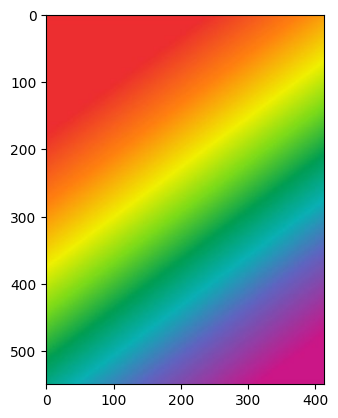

In [118]:
plt.imshow(show_rainbow)

In [119]:
mask = np.zeros(rainbow.shape[:2],np.uint8)

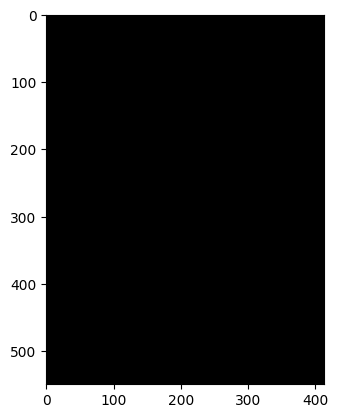

In [120]:
plt.imshow(mask,cmap='gray')

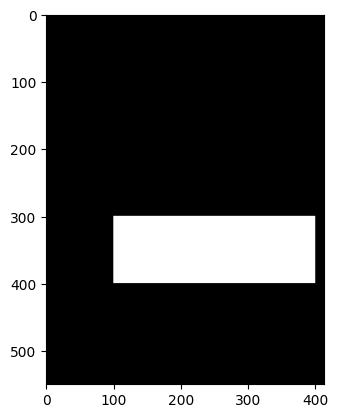

In [121]:
mask[300:400,100:400] = 255
plt.imshow(mask,cmap='gray')

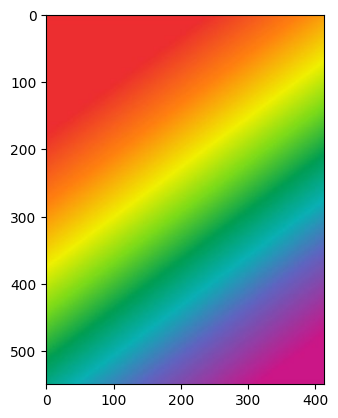

In [122]:
plt.imshow(show_rainbow)

In [124]:
img = rainbow

In [126]:
masked_image = cv2.bitwise_and(img,img,mask=mask)  ## This is for histogram calculation
show_masked_image = cv2.bitwise_and(show_rainbow,show_rainbow,mask=mask)  ## This is for visualization purposes


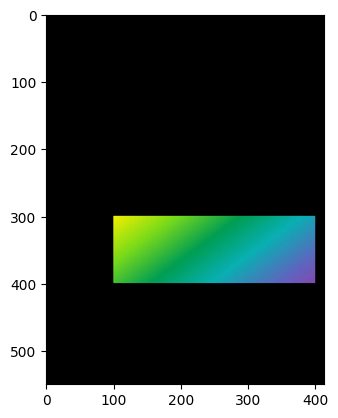

In [127]:
plt.imshow(show_masked_image)

In [128]:
hist_mask_values_red = cv2.calcHist([img],[2],mask,[256],[0,256])
hist_values_red = cv2.calcHist([img],[2],None,[256],[0,256])


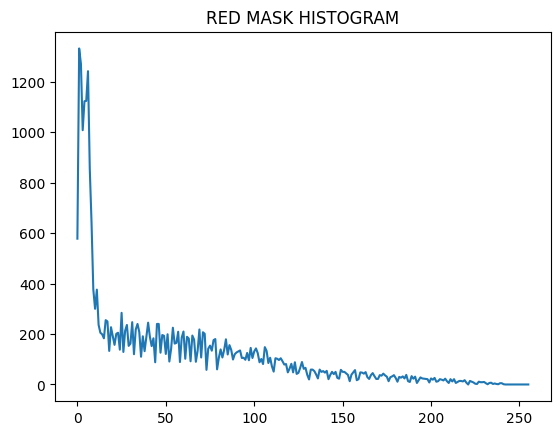

In [130]:
plt.plot(hist_mask_values_red)
plt.title("RED MASK HISTOGRAM")
plt.show()

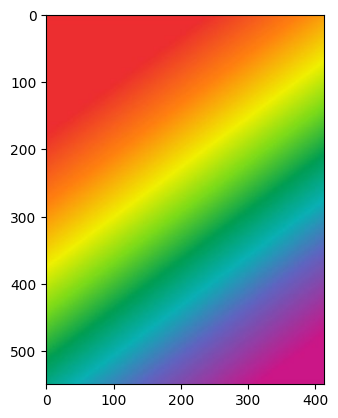

In [131]:
plt.imshow(show_rainbow)

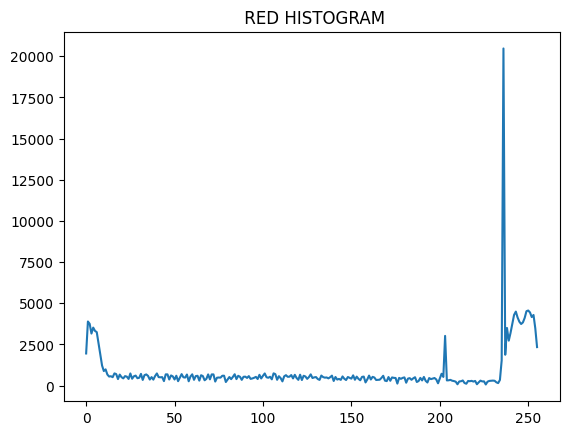

In [132]:
plt.plot(hist_values_red)
plt.title(" RED HISTOGRAM")
plt.show()

In [133]:
gorilla = cv2.imread('gdrive/My Drive/Datasets/DATA/gorilla.jpg',0)


In [134]:
def display_image(img,cmap="None"):
  fig = plt.figure(figsize=(12,10))
  ax = fig.add_subplot(111)
  ax.imshow(img,cmap='gray')

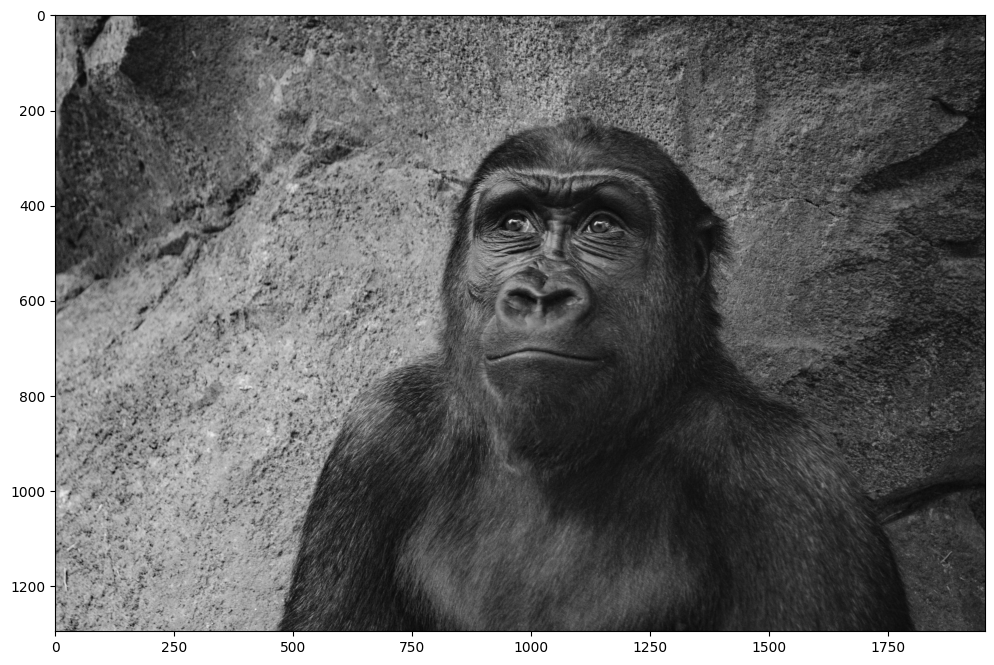

In [135]:
display_image(gorilla,cmap='gray')

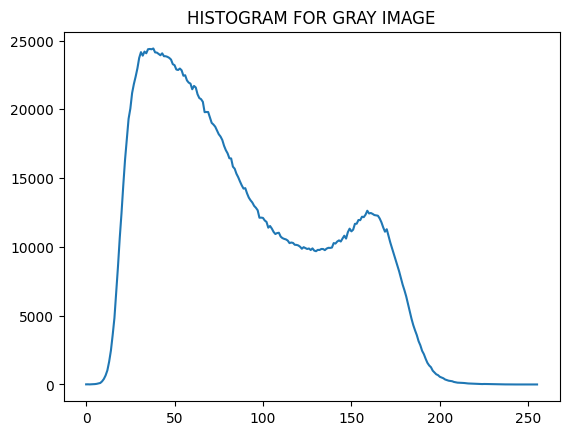

In [136]:
hist_values = cv2.calcHist([gorilla],[0],None,[256],[0,256])
plt.plot(hist_values)
plt.title("HISTOGRAM FOR GRAY IMAGE")
plt.show()


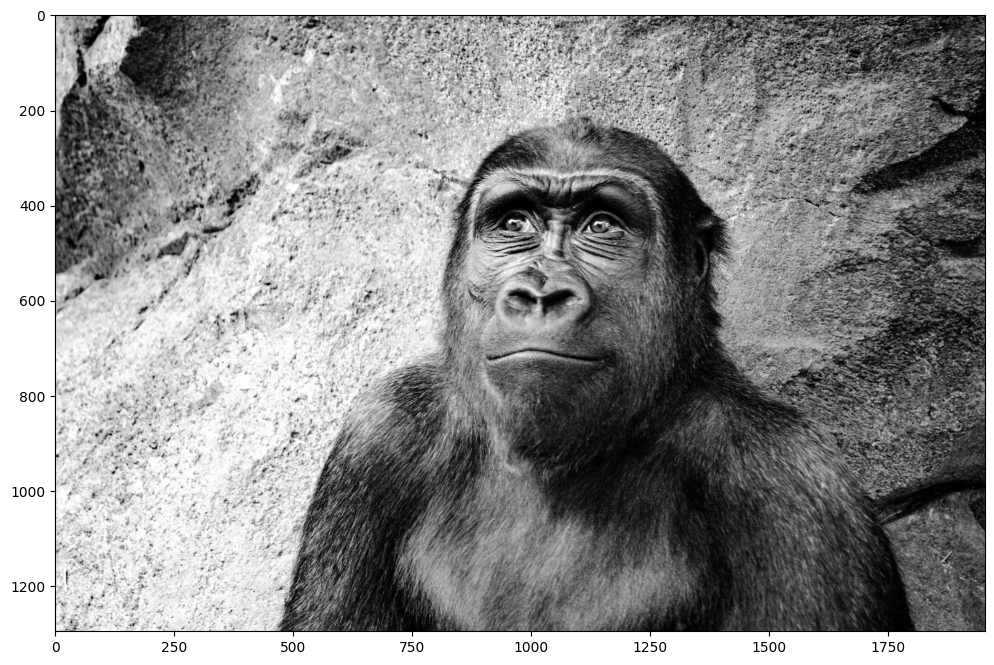

In [138]:
eq_gorilla = cv2.equalizeHist(gorilla)
display_image(eq_gorilla,cmap='gray')

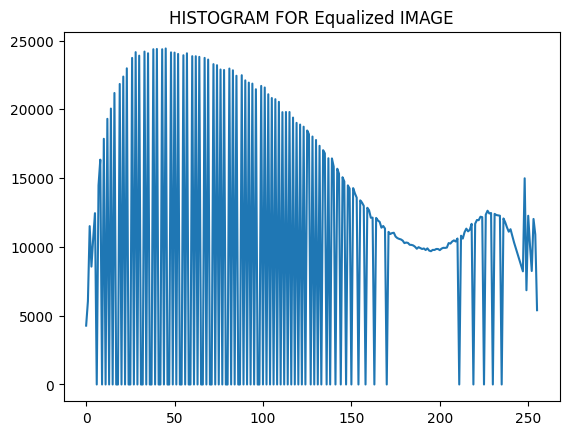

In [139]:
hist_values = cv2.calcHist([eq_gorilla],[0],None,[256],[0,256])
plt.plot(hist_values)
plt.title("HISTOGRAM FOR Equalized IMAGE")
plt.show()


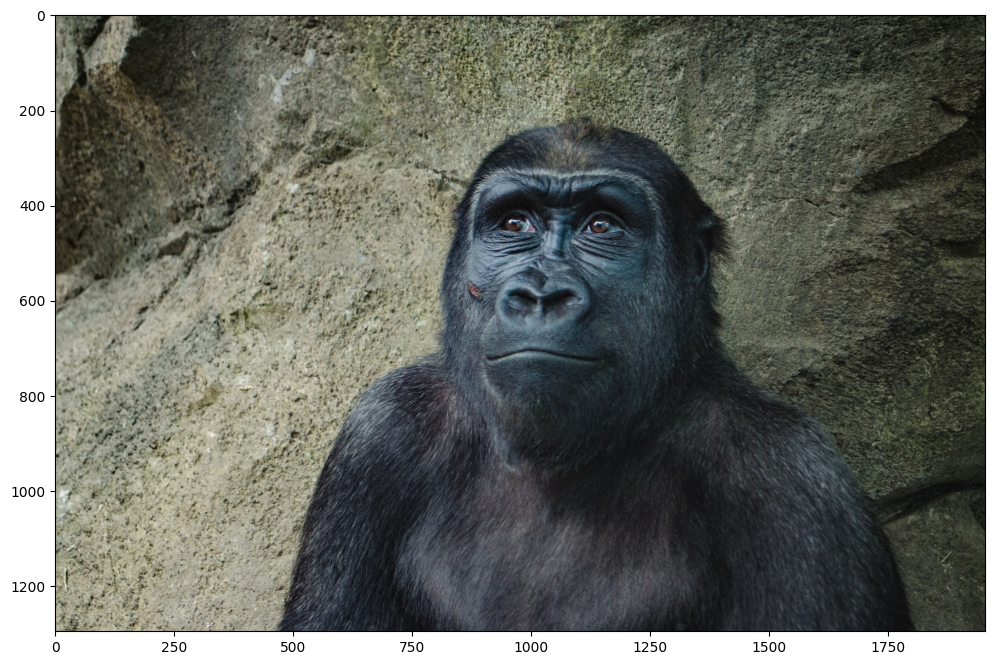

In [140]:
color_gorilla = cv2.imread('gdrive/My Drive/Datasets/DATA/gorilla.jpg')
show_color_gorilla = cv2.cvtColor(color_gorilla,cv2.COLOR_BGR2RGB)
display_image(show_color_gorilla)

In [142]:
hsv = cv2.cvtColor(color_gorilla,cv2.COLOR_BGR2HSV)
hsv[:,:,2].min()

np.uint8(1)